# Assignment B

## Motivation 
Our goal for this project is to explore what makes movies popular, in order to do this we will need a set of movies to study in terms of rating, plot and actors in order to determine if any elements are reoccuring for the success of a movie. It might be the actors, it might be common plot elements, or it may be a combination of all these. During the course of this explainer page we will go over the thoughts, ideas, analysis and learnings of exploring movie data.

- __What is your dataset?__

Our dataset consists of two parts firstly a list of 1000 popular movies. The list includes data on title, genre, production year etc. of all the movies.  The second part of the dataset is the respective Wikipedia pages of the movies. Specifically, it’s the plot and cast section of the wiki pages. The movie list is from Kaggle, while the wiki pages are found on Wikipedia. The base dataset can be found here:
https://www.kaggle.com/PromptCloudHQ/imdb-data

- __Why did you choose this/these particular dataset(s)?__

The dataset fits the purpose of the project in different ways. Firstly, the set does contain both bad & unpopular movies, which gives us a comparison basis to explore. Secondly, the wiki pages provides us with a large amount of data, that we can do text analysis on to see if there is some distinct patterns to a good/bad movie.

- __What was your goal for the end user's experience?__

The user experience goal is to provide an interesting analysis that highlights learnings generated throughout the course of this assignment and to display these in an understandable manner. We will directly enable data exploration in the plots, but leave the users with access to our data so they may explore this themselves.


## Basic stats
- __Write about your choices in data cleaning and preprocessing__

The dataset contained a csv file of 1000 movies. To get more information on the movies, we wanted to scrape Wikipedia for data from the respective wiki pages of each movie. Accessing data from Wikipedia is easy with the Wikipedia library in Python. However, since there is some inconsistency in the Wikipage names, some of the movies where hard to find (in some cases impossible to find). In order to combat this, we implemented our download script to try out different combination of possible Wikipage names for a movie (i.e. movie name plus the word film and the the production year). This approach worked well for almost all the movies we needed, however left us with some missing movies, it was soon discovered these could not be found due to spelling differences or titles being in different languages etc. Since it was just a few missing movies we left them out of the analysis.  

- __Write a short section that discusses the dataset stats (here you can recycle the work you did for Project Assignment A)__

Our dataset consists of 1000 movies (303kb, 1000 rows and 12 variables), the data includes: title, genre, short description, actors, year, length, ratings and revenue. In addition, we have also generated text files corresponding to the wiki pages of each movie. The Wikipedia data consists of 2000 files totaling 4 mb (find out precise numbers). The Wikipedia data, are text files from the plot and the cast section of the respective wiki pages. 
Initially, focusing on the actor interconnectivity we have 1985 nodes and 11994 links, in the actor graph the nodes have no attributes. In the movie graph however, there are multiple node attributes, such as rating, meta rating, number of votes and revenue.


## Tools, theory and analysis.
- __Talk about how you've worked with text, including regular expressions, unicode, etc.__

Overall for the project we have worked with our kaggle data in addition to wikipedia data. The latter has been processed to remove stopwords, newlines, numbers etc. In order to accomplish these we have used regex and the nltk pack (stop words, corpus etc). In order to get the wikipedia data we have also used a library called wikipedia which has the ability to extract section data directly off wikipedia rather than having to process the raw page extracts.

- __Describe which network science tools and data analysis strategies you've used, how those network science measures work, and why the tools you've chosen are right for the problem you're solving.__

During the course of the project (see below) we have used network tools such as networkx for creating graphs for the networks in order to explore connectivity. This includes the use of timeline based network plot, degree distributions and community analysis. Our initial approach to the analysis was to start exploring commonalities, such as actors and movie plots

- __How did you use the tools to understand your dataset?__

The different visualisation styles and customization options allowed us to visualize the plot in different manners to try and explore trends. The network visualizations present a powerful tool to represent and understand complex data via visualization.

### Actor & movie networks analysis
Let us begin the analysis by looking at the network of actors connected per movie. This should give us an idea of what the communities look like and how the nodes interconnect. We would like to explore which actors are the most connected and in turn which movies.

In order to explore this we will use networkx, force atlas and community to explore these attributes.

Firstly, we will begin by preparing the data:

In [1]:
import io
import re
import networkx as nx
import matplotlib.pyplot as plt
from networkx.algorithms import bipartite
import numpy as np
import random as rm
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import io

moviedata = pd.read_csv('moviedata.csv')
linklist = []
nodes = []
movie_nodes = []
movie_links = []

#First round of processing, data is sorted to movie and actor nodes respectively
for index, row in moviedata.iterrows():
    movie_nodes.append(row.Title)
    
    for j in list(row.Actors.replace(", ",",").split(",")):
        nodes.append(j)
        movie_links.append((row.Title,j))
        for n in list(row.Actors.replace(", ",",").split(",")):
            linklist.append((j,n))

#If a movie shares an actor with another movie, this connects the movies 
p_movie_links = []
for i in movie_links:
    for j in movie_links:
        if(i[1] == j[1]):
            p_movie_links.append((i[0],j[0]))

#Removes doublicates from actor links
nodes = list(set(nodes))
G = nx.DiGraph()
G.add_edges_from(linklist)
linklist = [i for i in linklist if i not in G.selfloop_edges()]
G.remove_edges_from(G.selfloop_edges())

#Print sizes:
print(len(nodes))
print(len(linklist))

print(len(movie_nodes))
print(len(p_movie_links))

1985
11994
1000
16083


We can now plot the network:

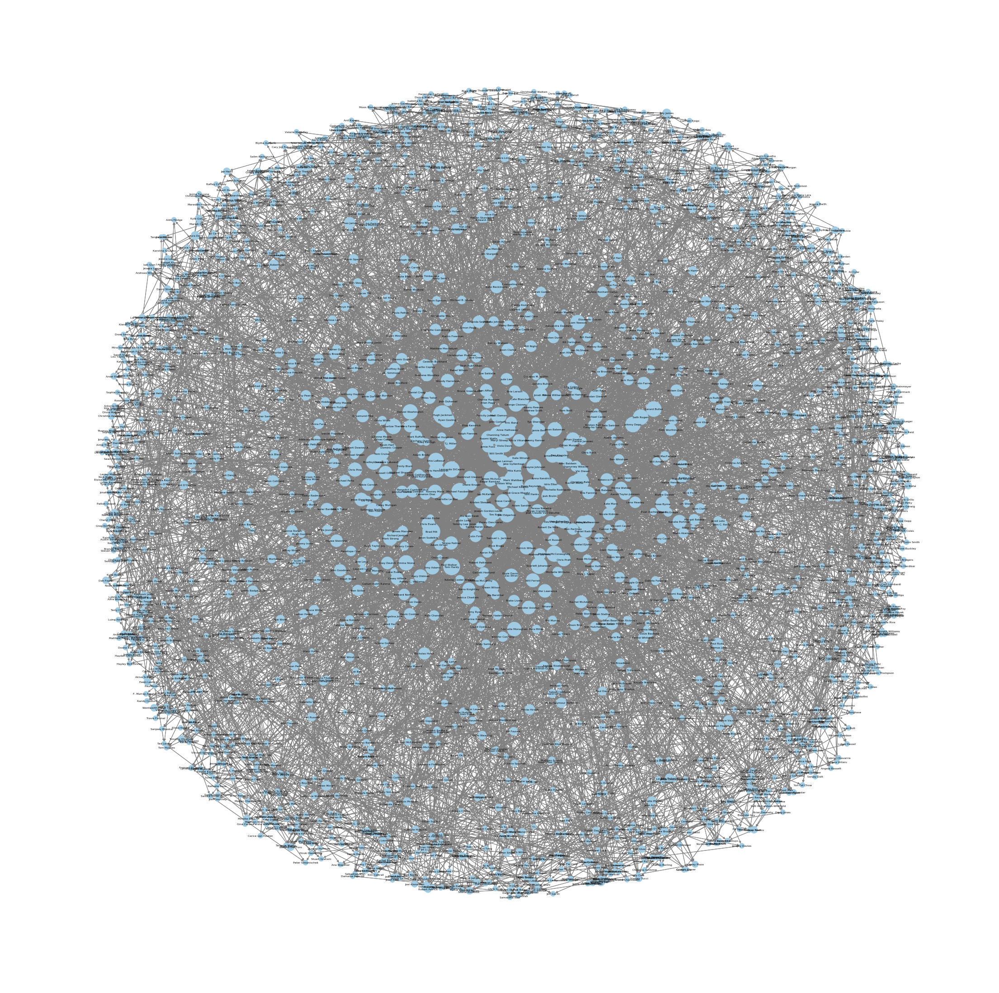

In [2]:
#Plot actor connectivity
d=G.degree()
plt.figure(1,figsize=(30,30))
pos=nx.spring_layout(G,k=20/(G.number_of_nodes()**0.5))
nx.draw(G, with_labels = True, node_size=[v[1] * 20 for v in d],font_size=6,pos=pos,edge_color='grey',node_color='#A0CBE2')
plt.show()

In the above plot we can see the actor interconnectivty is quite high. We can start seeing patters for which actors are more popular to cast in the movies. Alternatively we may visualize this using the force atlas algorithm:

In [3]:
from fa2 import ForceAtlas2

G_und = G.to_undirected()
dict(G_und.degree()).values()
forceatlas2 = ForceAtlas2(
                          # Behavior alternatives
                          outboundAttractionDistribution=False,  # Dissuade hubs
                          linLogMode=False,  # NOT IMPLEMENTED
                          adjustSizes=False,  # Prevent overlap (NOT IMPLEMENTED)
                          edgeWeightInfluence=1.0,

                          # Performance
                          jitterTolerance=1.0,  # Tolerance
                          barnesHutOptimize=True,
                          barnesHutTheta=1.2,
                          multiThreaded=False,  # NOT IMPLEMENTED

                          # Tuning
                          scalingRatio=2.0,
                          strongGravityMode=False,
                          gravity=20.0,

                          # Log
                          verbose=True)

positions = forceatlas2.forceatlas2_networkx_layout(G_und, pos=None, iterations=100)

100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [00:04<00:00, 20.28it/s]


BarnesHut Approximation  took  1.13  seconds
Repulsion forces  took  3.69  seconds
Gravitational forces  took  0.02  seconds
Attraction forces  took  0.01  seconds
AdjustSpeedAndApplyForces step  took  0.08  seconds


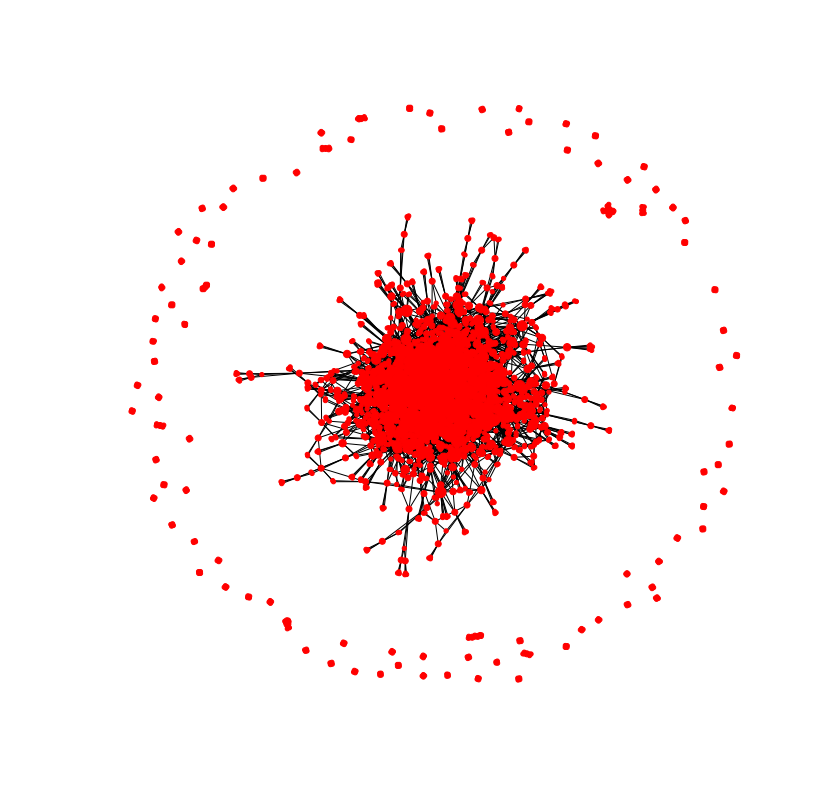

In [4]:
#Create figure:
plt.figure(figsize=(14,14))
nx.draw_networkx(G_und, pos=positions,with_labels=False, front_weight='bold',node_size=[6*i for i in dict(G_und.degree()).values()])
plt.xlim(-1450,1450)
plt.ylim(-1450,1450)
plt.axis('off')
plt.show()

Force atlas representation of our actor network plot where node size is dependant on degrees for each node. It is evident from the plot we have one large component and several smaller ones, these are of course movies which do not share actors with other movies. We can also see from the plot that it ressembles a Supercritical Regime. 

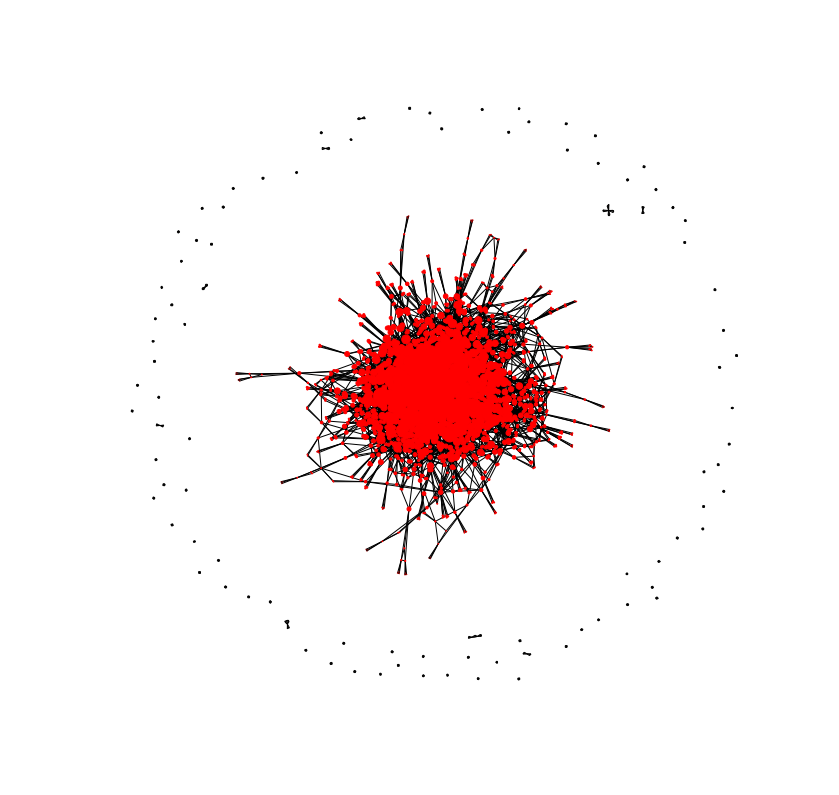

In [5]:
#Create eigenvector graph
plt.figure(figsize=(14,14))
bet_eig = nx.eigenvector_centrality(G)
nx.draw_networkx(G_und, pos=positions,with_labels=False, front_weight='bold',node_size=[bet_eig[i]*2000 for i in G_und.nodes()])
plt.xlim(-1450,1450)
plt.ylim(-1450,1450)
plt.axis('off')
plt.show()

Force atlas plot of the actor network where the node size is dependant on eigen vector centrality. Initially this plot provides us with an idea of each nodes realative influence, based on the scores of its connecions, thus nodes connected to other high degree nodes are highlighted more clearly. As expected this highlights the more centralized nodes.

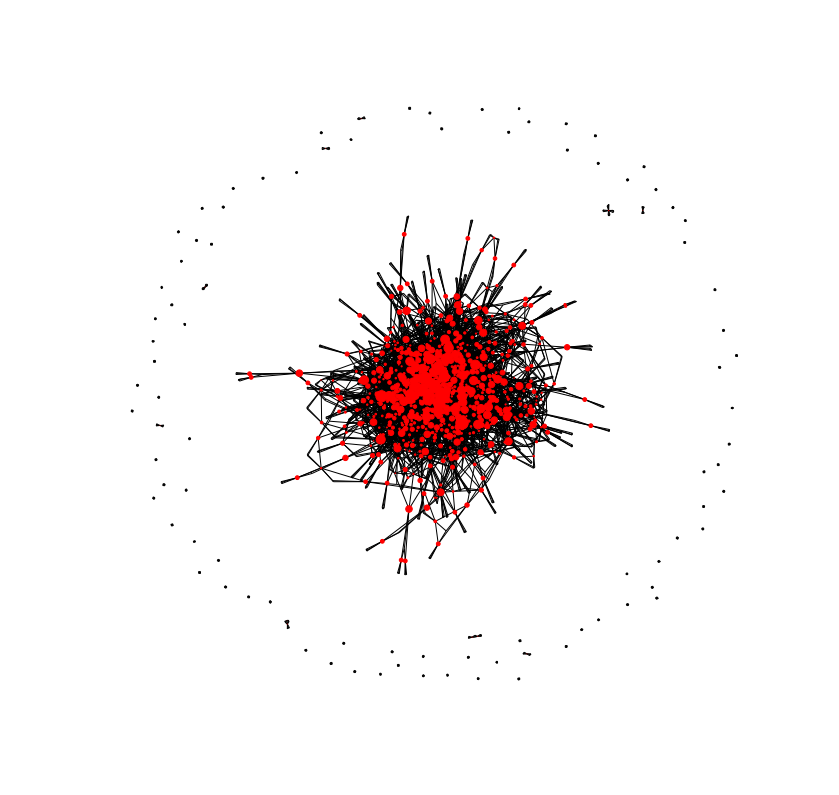

In [6]:
#Create Betweenness graph:
plt.figure(figsize=(14,14))
bet = nx.betweenness_centrality(G)
nx.draw_networkx(G_und, pos=positions,with_labels=False, front_weight='bold',node_size=[bet[i]*6000 for i in G_und.nodes()])
plt.xlim(-1450,1450)
plt.ylim(-1450,1450)
plt.axis('off')
plt.show()

Force atlas plot of the actor network where node size is dependant on the betweeness centrality. Effectively this highlighting nodes with the most shortest paths though the network. Effectively these represent the degree of which nodes stand between one another, or the most central to the network being connected.

Lets look at the degree distribution of the network:

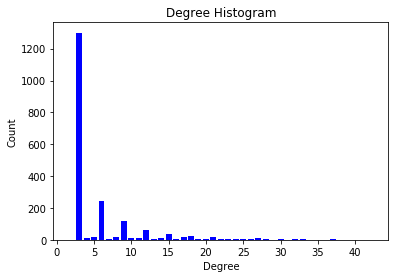

In [7]:
#Create histogram of degrees
import collections
degree_sequence = sorted([d for n, d in G_und.degree()], reverse=True)  # degree sequence
degreeCount = collections.Counter(degree_sequence)
deg, cnt = zip(*degreeCount.items())

fig, ax = plt.subplots()
plt.bar(deg, cnt, width=0.80, color='b')

plt.title("Degree Histogram")
plt.ylabel("Count")
plt.xlabel("Degree")
plt.show()

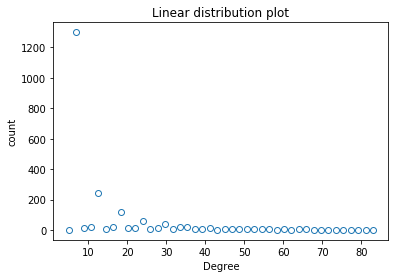

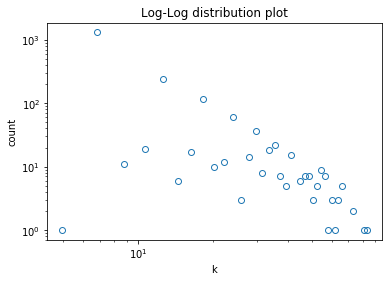

In [8]:
# Create linear distribution and loglog plot
maxd = max([int(j) for i,j in G_und.degree()])
mind = min([int(j) for i,j in G_und.degree()])
degreeslist = [int(j) for i,j in G_und.degree()]
hist, binList = np.histogram(degreeslist, maxd)
plt.plot((binList[1:]+binList[:-1]),hist, 'o', mfc='none')
plt.title("Linear distribution plot")
plt.ylabel('count')
plt.xlabel("Degree")
plt.show()
#Generate log-log plot
plt.loglog((binList[1:]+binList[:-1]),hist, 'o', mfc='none')
plt.title("Log-Log distribution plot")
plt.xlabel('k')
plt.ylabel('count')
plt.show()

It should be noted that the distributions of degrees do not resemble any we have worked with in class, this can be accounted for by the fact that movies are rarely made with single actors, rather they usually have several main actors.

In [9]:
#Print most connected nodes by different measures
import operator
def sort_print_top3(dictionary):
    print(sorted([(i[0],dictionary[i[0]]) for i in G_und.nodes(data = True)],key = lambda x:x[1])[-10:],"\n")


und_degree = dict(G_und.degree())
print("Highest degrees")
sort_print_top3(und_degree)
print("Highest betweeness")
sort_print_top3(bet)
print("Highest eigenvector")
sort_print_top3(bet_eig)


Highest degrees
[('Chloë Grace Moretz', 32), ('Michael Fassbender', 33), ('Anne Hathaway', 33), ('Jake Gyllenhaal', 33), ('Tom Hardy', 33), ('Channing Tatum', 33), ('Christian Bale', 37), ('Brad Pitt', 37), ('Hugh Jackman', 41), ('Mark Wahlberg', 42)] 

Highest betweeness
[('Chloë Grace Moretz', 0.015051277694188257), ('Brad Pitt', 0.01532937250881317), ('Tom Hardy', 0.015752562762057963), ('Matthew McConaughey', 0.016513517147245343), ('Sharlto Copley', 0.016524995617116692), ('Charlize Theron', 0.017552710060818474), ('Hugh Jackman', 0.020767781714828865), ('Christian Bale', 0.022547365982506805), ('Channing Tatum', 0.025788127210341915), ('Mark Wahlberg', 0.026482896780064404)] 

Highest eigenvector
[('Tom Hardy', 0.113695448524933), ('Leonardo DiCaprio', 0.11636259764842105), ('Jake Gyllenhaal', 0.11651535177764859), ('Matt Damon', 0.1165236627557627), ('Anne Hathaway', 0.12713004686235388), ('Mark Wahlberg', 0.13088360019774828), ('Scarlett Johansson', 0.1325080510722002), ('Brad 

If we look at the most connected actors of each of our plots (degree, betweeness and eigen) we see that the most connected actors are the famous ones we might expect, e.i. the high end actors. This means that they are the most connected actors likely because they star in many films, rather than a few.

As expected serveral high end actors also show up in the most connected in betweeness centrality, however this also contains several relatively unknown actors, these can be accounted for by the nature of betweeness centrality and the fact that they bridge the graph between high end and low end actors.

The highest eigenvecor connected names, are as expected once more high end actors that star in movies with other highend actors, as indicated by our reults.

In [10]:
#Find the partition and print the modularity
import community
#first compute the best partition
partition = community.best_partition(G_und)
print(community.modularity(partition,G_und))

0.6248575593058865


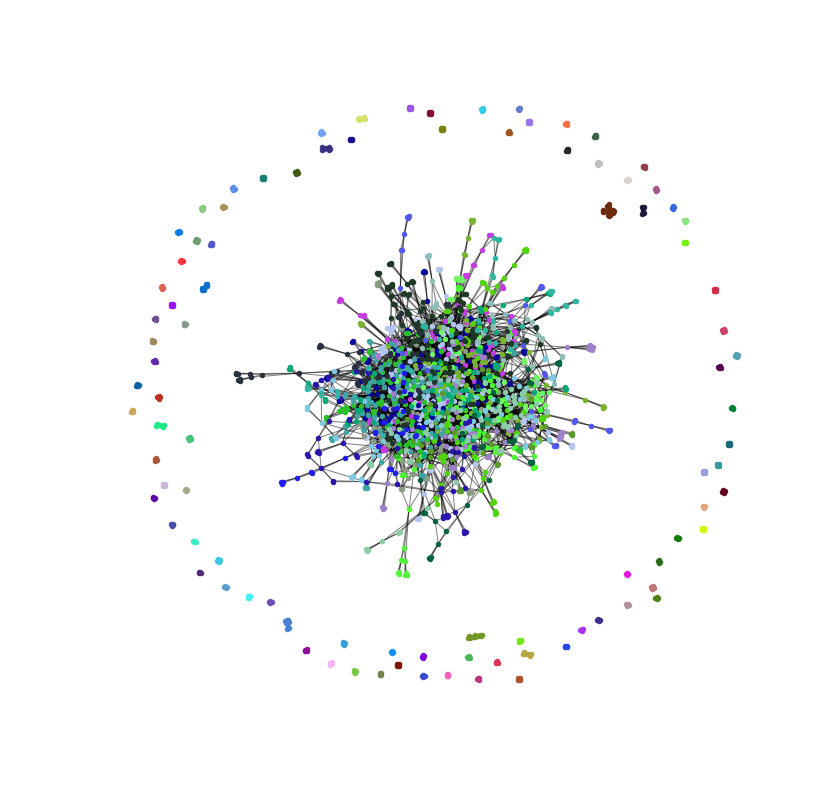

In [11]:
#Generate colors:
import random

COLORS = [(139, 0, 0), 
          (0, 100, 0),
          (0, 0, 139)]

def random_color():
    return random.choice(COLORS)

#begin figure
plt.figure(figsize=(14,14))
plt.xlim(-1450,1450)
plt.ylim(-1450,1450)
plt.axis('off')
#Create communities graph:
count = 0.
for com in set(partition.values()) :
    count = count + 1.
    list_nodes = [nodes for nodes in partition.keys()
                                if partition[nodes] == com]
    nx.draw_networkx_nodes(G_und, positions, list_nodes, node_size = 20,
                                node_color = np.random.rand(1,4))


nx.draw_networkx_edges(G_und,positions, alpha=0.5)
plt.show()

Community netowrk plot with randomly generated node colors for each community.

In [12]:
import prettytable # Requires pip install prettytable in the conda console 

#prints the community matrix
c_matrix = []
for com in set(partition.values()):
    list_nodes = [nodes for nodes in partition.keys() if partition[nodes] == com]
    c_matrix.append([com,len(list_nodes)])

x = prettytable.PrettyTable(["Community:","Count"])

for n in c_matrix:    
    x.add_row([n[0], n[1]])

print(x)

+------------+-------+
| Community: | Count |
+------------+-------+
|     0      |  159  |
|     1      |   71  |
|     2      |   93  |
|     3      |   69  |
|     4      |   90  |
|     5      |   94  |
|     6      |   83  |
|     7      |  106  |
|     8      |   71  |
|     9      |   46  |
|     10     |   59  |
|     11     |   69  |
|     12     |   57  |
|     13     |   76  |
|     14     |   62  |
|     15     |   4   |
|     16     |   54  |
|     17     |   4   |
|     18     |   4   |
|     19     |   4   |
|     20     |  100  |
|     21     |   32  |
|     22     |   4   |
|     23     |   4   |
|     24     |   30  |
|     25     |   48  |
|     26     |   47  |
|     27     |   32  |
|     28     |   27  |
|     29     |   7   |
|     30     |   4   |
|     31     |   4   |
|     32     |   4   |
|     33     |   13  |
|     34     |   4   |
|     35     |   4   |
|     36     |   4   |
|     37     |   4   |
|     38     |   4   |
|     39     |   4   |
|     40   

When plotting the network for communities, several communities of highly interconnected actors appear, in which many participate in multiple movies togeather, so this interconnectivity makes sense in terms of hollywood movies. It can be noticed from the print that many actors are in smaller movie based communities, E.i. actors connected by their other staring actors. Some strongly connected communities also emerge representing the high payed actors connected with one another.

Overall during the above visualizations we have learned that the actors are connected to one another in differnet communitys and that some actors are clearly more popular than others (connecivity) meaning they star in many movies, Whether or not this is something that leads to the popularity of the movies is however still unanswered, and is something we will explore further in the upcoming section.

#### Movie plots
Now that we have had a look at actors, its time to look at how the movies themselves are connected by actors, in this case movies that share actors have been linked together with the movies serving as the nodes. Once more we will be using networkx to explore different forms of visualizations.

100%|████████████████████████████████████████████████████████████████████████████████| 200/200 [00:06<00:00, 30.07it/s]


BarnesHut Approximation  took  0.67  seconds
Repulsion forces  took  5.80  seconds
Gravitational forces  took  0.04  seconds
Attraction forces  took  0.02  seconds
AdjustSpeedAndApplyForces step  took  0.05  seconds


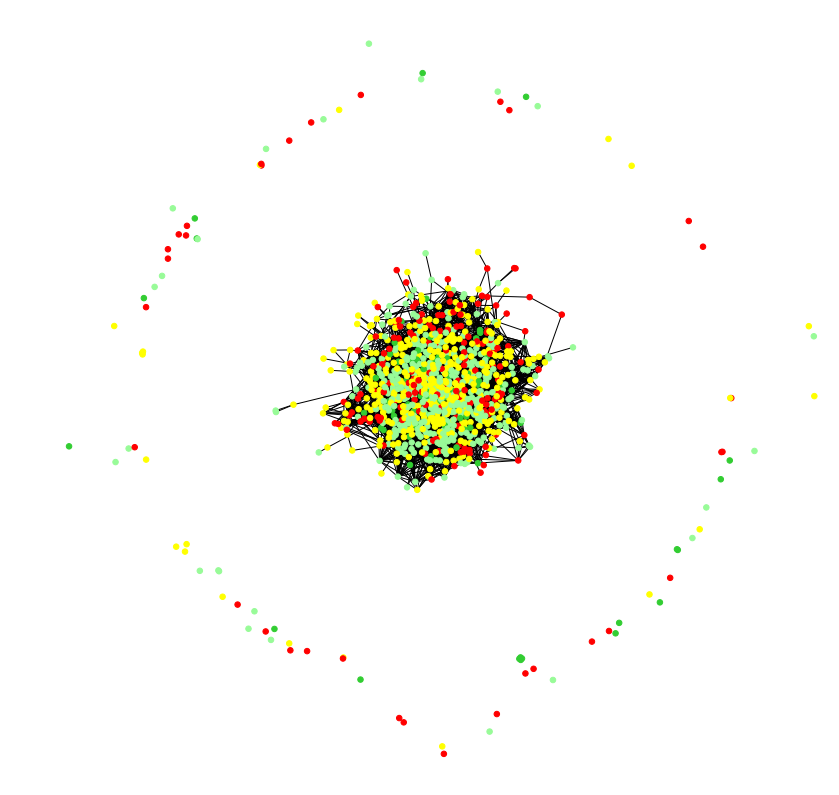

In [13]:
G_m = nx.DiGraph()


#Set node attributes
for i in movie_nodes:
    n = moviedata.loc[moviedata['Title'] == i]
    G_m.add_node(i, attr_dict = {'Rating' : n.Rating.astype(float),'Income' : n.Revenue.astype(float),'Score': n.Metascore, 'Votes':n.Votes})

#Remove doublicates
G_m.add_edges_from(p_movie_links)
G_m.remove_edges_from(G_m.selfloop_edges())
G_und_m = G_m.to_undirected()

#Generate colors:
cols = []
for i in G_und_m.nodes():
    try:
        if int(G_m.node[i]['attr_dict']['Rating']) >= 8:
            cols.append('#32CD32');
        elif int(G_m.node[i]['attr_dict']['Rating']) >= 7:
            cols.append('#98FB98')
        elif int(G_m.node[i]['attr_dict']['Rating']) >= 6: 
            cols.append('#ffff00')
        else: 
            cols.append('#ff0000')
    except:
        cols.append('#ff0000')


positions_m = forceatlas2.forceatlas2_networkx_layout(G_und_m, pos=None, iterations=200)
    
#Create movie figure:
plt.figure(figsize=(14,14))
nx.draw_networkx(G_und_m, pos=positions_m,with_labels=False, front_weight='bold',node_size=30,node_color=cols)
plt.xlim(-1450,1450)
plt.ylim(-1450,1450)
plt.axis('off')
plt.show()

As previously with the actor plots we can see isolated groups of movies, we also see a large connected component.

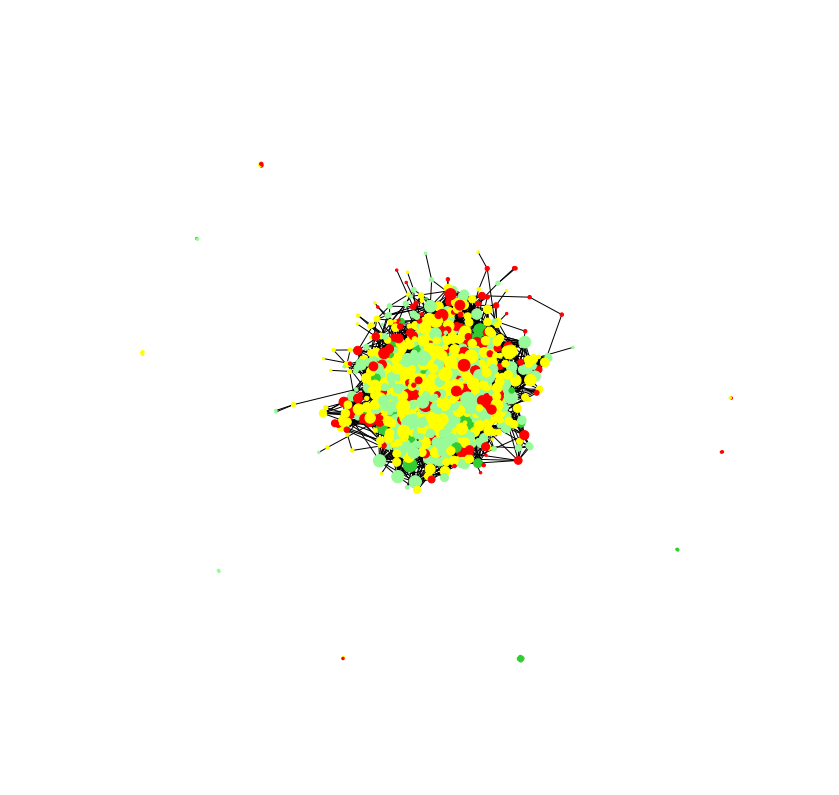

In [14]:
#Create movie figure:
plt.figure(figsize=(14,14))
nx.draw_networkx(G_und_m, pos=positions_m,with_labels=False, front_weight='bold',node_size=[6*i for i in dict(G_und_m.degree()).values()],node_color=cols)
plt.xlim(-1450,1450)
plt.ylim(-1450,1450)
plt.axis('off')
plt.show()

Force atlas plot of movies, with colors based on movie ratings with node sizes being based on degrees.

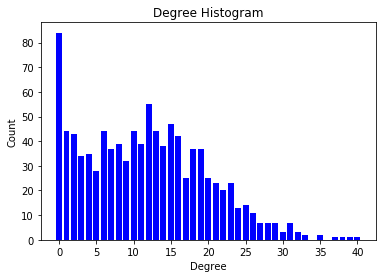

In [15]:
#print degree distribution for movie plot
degree_sequence = sorted([d for n, d in G_und_m.degree()], reverse=True)
degreeCount = collections.Counter(degree_sequence)
deg, cnt = zip(*degreeCount.items())

fig, ax = plt.subplots()
plt.bar(deg, cnt, width=0.80, color='b')

plt.title("Degree Histogram")
plt.ylabel("Count")
plt.xlabel("Degree")
plt.show()

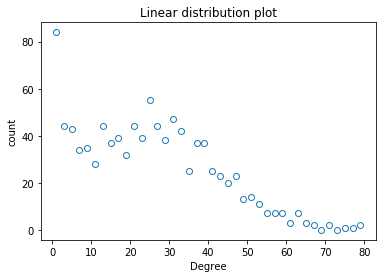

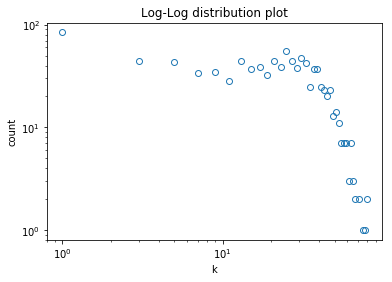

In [16]:
#Create linear distribution plot and loglog
maxd = max([int(j) for i,j in G_und_m.degree()])
mind = min([int(j) for i,j in G_und_m.degree()])
degreeslist = [int(j) for i,j in G_und_m.degree()]
hist, binList = np.histogram(degreeslist, maxd)
plt.plot((binList[1:]+binList[:-1]),hist, 'o', mfc='none')
plt.title("Linear distribution plot")
plt.ylabel('count')
plt.xlabel("Degree")
plt.show()
#Generate log-log plot
plt.loglog((binList[1:]+binList[:-1]),hist, 'o', mfc='none')
plt.title("Log-Log distribution plot")
plt.xlabel('k')
plt.ylabel('count')
plt.show()

The degree distribution of the network still somewhat resembles the previously seen degree distribution from the previous section. In this case the network plots are closer towards a power law, scale free network rather than a truly random network. However these are still quite far from an expected power law distribution.

(array([  1.,   3.,   8.,  20.,  55., 154., 283., 281., 172.,  23.]),
 array([1.9 , 2.61, 3.32, 4.03, 4.74, 5.45, 6.16, 6.87, 7.58, 8.29, 9.  ]),
 <a list of 10 Patch objects>)

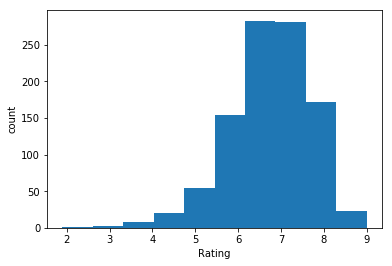

In [17]:
#Ratings histogram
plt.ylabel('count')
plt.xlabel("Rating")
plt.hist(moviedata.Rating)

Above we can see the rating distribution accross movies, meaning most movies lie somewhere in the range of 5-8 in terms of their rating, thus this measure in of itself is not enough to determine a movies popularity.

We can now change the plot and explore it from different aspects. Lets start with chaning the size of nodes to be based on the income of the movies.

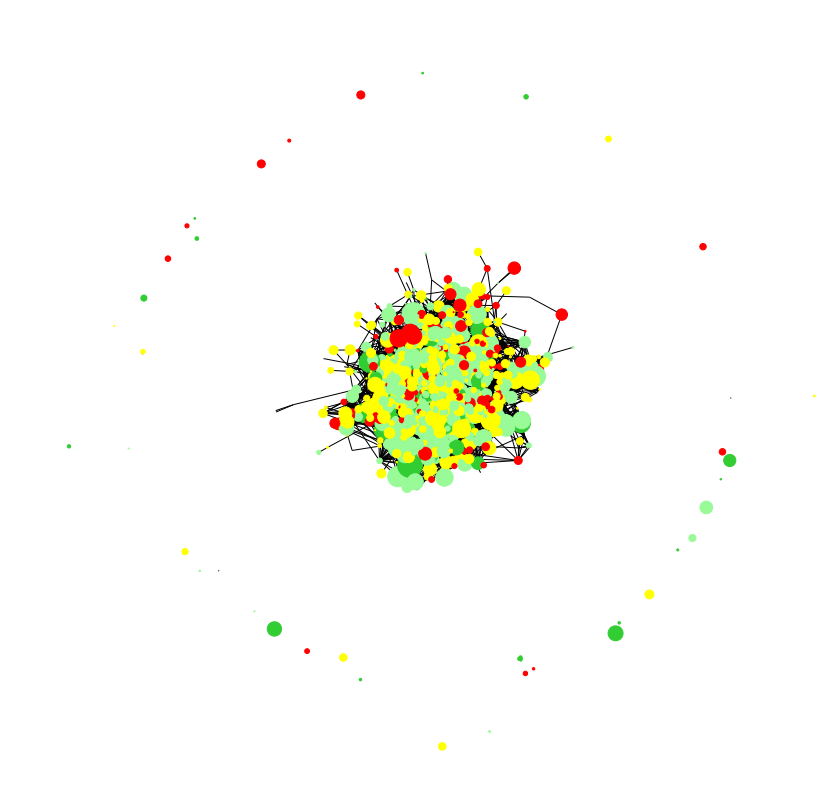

In [18]:
#Create where income determines node size, and colors are rating:
node_size = []
for i in G_und_m.nodes():
    try:
        node_size.append(int(G_m.node[i]['attr_dict']['Income']))
    except:
        node_size.append(0)

plt.figure(figsize=(14,14))
nx.draw_networkx(G_und_m, pos=positions_m,with_labels=False, front_weight='bold',node_size=node_size,node_color=cols)
plt.xlim(-1450,1450)
plt.ylim(-1450,1450)
plt.axis('off')
plt.show()

In the above plot we can see that most movies with good ratings (green/light green) seems to have high incomes, however there seems to be several exceptions to this. We also see that a large number of the movies not connected to the large connected component disappears as these have had a very low revenue. 

(array([741., 151.,  56.,  33.,  11.,   3.,   2.,   0.,   1.,   1.]),
 array([  0. ,  93.6, 187.2, 280.8, 374.4, 468. , 561.6, 655.2, 748.8,
        842.4, 936. ]),
 <a list of 10 Patch objects>)

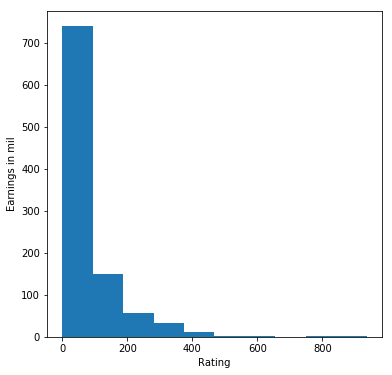

In [19]:
#Plot the movie earnings
plt.figure(figsize=(6,6))
plt.ylabel("Earnings in mil")
plt.xlabel("Rating")
plt.hist(node_size)

The histogram distribution seems to highlight that very few movies have high earnings. However this histogram tells us little about the correlation between earnings and rating, which might be used to deduce popularity.

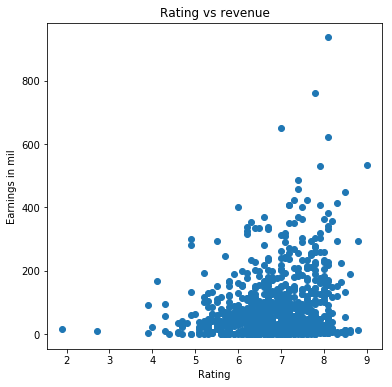

In [20]:
#plot movie rating vs earning:
plt.figure(figsize=(6,6))
plt.title("Rating vs revenue")
plt.ylabel("Earnings in mil")
plt.xlabel("Rating")
plt.plot(moviedata.Rating,moviedata.Revenue,"o")

Generally speaking highly rated movies seem to earn more money than lowly rated ones as can be seen from the above figure. For example only movies with ratings higher than 7 seems to earn more than 500 million. Thus highlighting there is a connection between rating and earnings. We may also conclude however that while low rated movies cannot get high earnings, that is no guarantee a high rated movie earns a good profit either. 

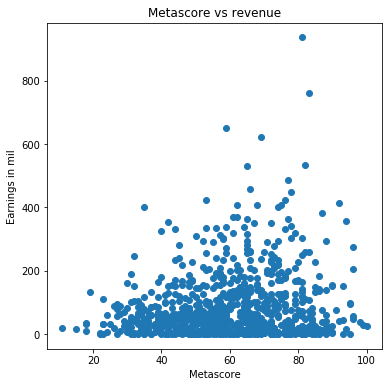

In [21]:
#plot movie rating vs earning:
plt.figure(figsize=(6,6))
plt.title("Metascore vs revenue")
plt.ylabel("Earnings in mil")
plt.xlabel("Metascore")
plt.plot(moviedata.Metascore,moviedata.Revenue,"o")

The above meta score is more varied in relation to the earnings. However generally a higher meta score seems to result in an average higher rating. 

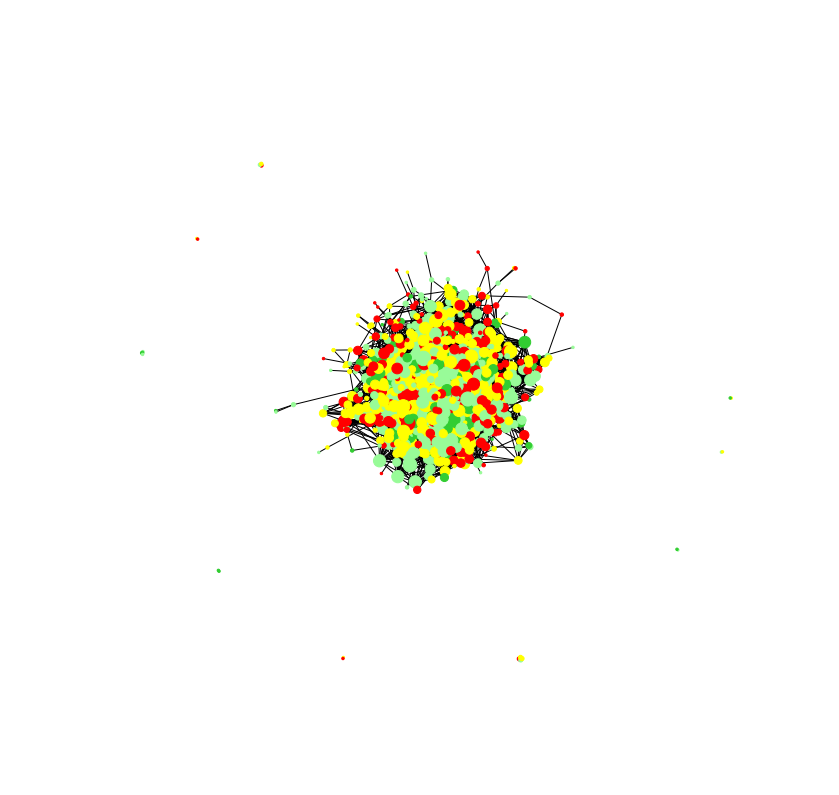

In [22]:
#Generate colors based on meta score:
cols = []
Scores = []
for i in G_und_m.nodes():
    try:
        Scores.append(int(G_m.node[i]['attr_dict']['Score']))
        if int(G_m.node[i]['attr_dict']['Score'] /10) >= 8:
            cols.append('#32CD32');
        elif int(G_m.node[i]['attr_dict']['Score']/10) >= 6:
            cols.append('#98FB98')
        elif int(G_m.node[i]['attr_dict']['Score']/10) >= 4: 
            cols.append('#ffff00')
        else: 
            cols.append('#ff0000')
    except:
        Scores.append(0)
        cols.append('#ff0000')

#Create figure:
plt.figure(figsize=(14,14))
nx.draw_networkx(G_und_m, pos=positions_m,with_labels=False, front_weight='bold',node_size=[6*i for i in dict(G_und_m.degree()).values()],node_color=cols)
plt.xlim(-1450,1450)
plt.ylim(-1450,1450)
plt.axis('off')
plt.show()

Plotting exclusively for movie connectivity and metascore does not provide us with distinguishable information. 

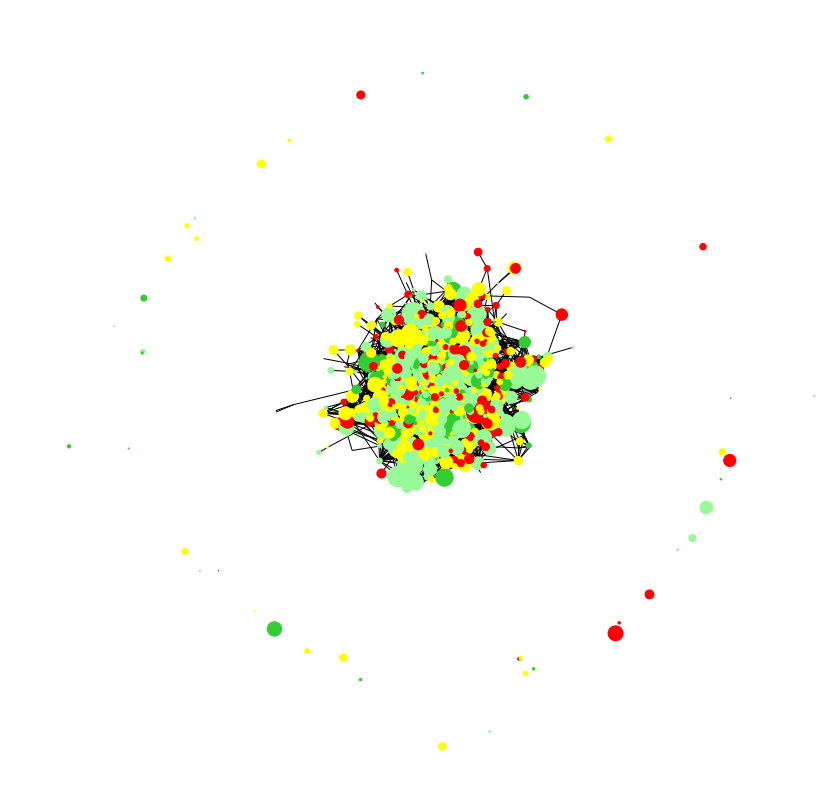

In [23]:
#Create figure where node size is movie earnings:
plt.figure(figsize=(14,14))
nx.draw_networkx(G_und_m, pos=positions_m,with_labels=False, front_weight='bold',node_size=node_size,node_color=cols)
plt.xlim(-1450,1450)
plt.ylim(-1450,1450)
plt.axis('off')
plt.show()

Initially chaning the node color based on meta score rather than imdb rating shows us nothing new. However plotting against earning as the node size we see that high rated meta score movies, clearly earn more than its low rated counter parts.

(array([ 65.,   8.,  29., 103., 145., 182., 196., 152.,  95.,  24.]),
 array([  0.,  10.,  20.,  30.,  40.,  50.,  60.,  70.,  80.,  90., 100.]),
 <a list of 10 Patch objects>)

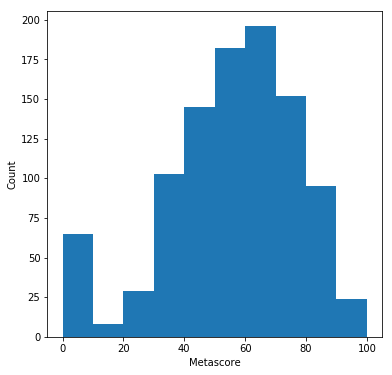

In [24]:
#plot average movie score
plt.figure(figsize=(6,6))
plt.ylabel("Count")
plt.xlabel("Metascore")
plt.hist(Scores)

As the histogram shows the user meta reviews are also slightly more diverse than its imdb counter part. We can now visualize the centrality using eigenvectors and betweeeness.

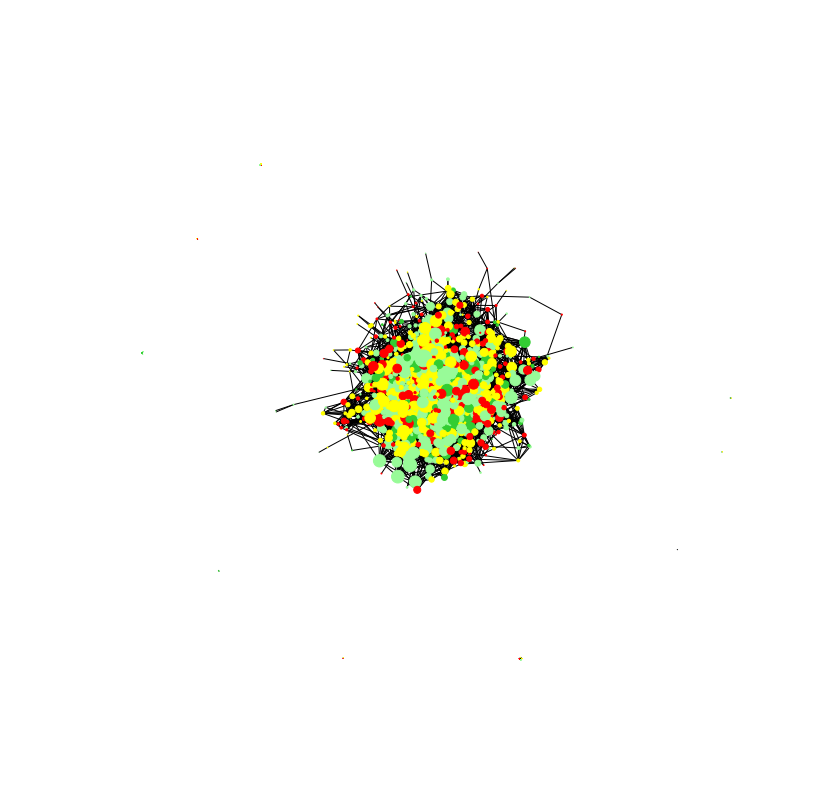

In [25]:
#Create Eigenvector graph
plt.figure(figsize=(14,14))
bet_eig = nx.eigenvector_centrality(G_und_m)
nx.draw_networkx(G_und_m, pos=positions_m,with_labels=False, front_weight='bold',node_size=[bet_eig[i]*2000 for i in G_und_m.nodes()],node_color=cols)
plt.xlim(-1450,1450)
plt.ylim(-1450,1450)
plt.axis('off')
plt.show()

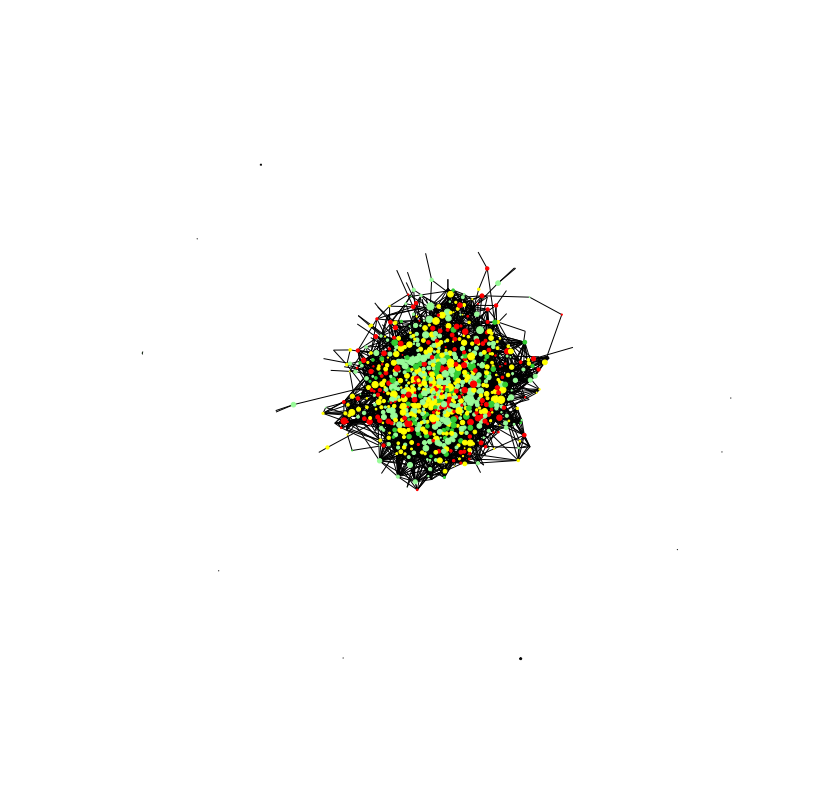

In [26]:
#Create betweenness graph.
plt.figure(figsize=(14,14))
bet = nx.betweenness_centrality(G_und_m)
nx.draw_networkx(G_und_m, pos=positions_m,with_labels=False, front_weight='bold',node_size=[bet[i]*6000 for i in G_und_m.nodes()],node_color=cols)
plt.xlim(-1450,1450)
plt.ylim(-1450,1450)
plt.axis('off')
plt.show()

In [27]:
#Plot most connected movies by different measures
def sort_print_top3(dictionary):
    print(sorted([(i[0],dictionary[i[0]]) for i in G_und_m.nodes(data = True)],key = lambda x:x[1])[-10:],"\n")

print("most connected movies")
und_degree = dict(G_und_m.degree())
print("Highest degrees")
sort_print_top3(und_degree)
print("Highest betweeness")
sort_print_top3(bet)
print("Highest eigenvector")
sort_print_top3(bet_eig)

most connected movies
Highest degrees
[('The Avengers', 32), ('The Departed', 32), ('Neighbors 2: Sorority Rising', 33), ('50/50', 33), ('Les Misérables', 35), ('The Fighter', 35), ('American Hustle', 37), ('The Big Short', 38), ('The Dark Knight Rises', 39), ('The Prestige', 40)] 

Highest betweeness
[('American Gangster', 0.008398659159022312), ('Neighbors 2: Sorority Rising', 0.008481245852285988), ('The Book of Life', 0.008493781583621886), ('American Hustle', 0.00863873426448633), ('Hancock', 0.008715510075035791), ('The Magnificent Seven', 0.008983352759737774), ('Snow White and the Huntsman', 0.009291364437932966), ('The Dark Knight Rises', 0.009411000685469226), ('Fury', 0.010209825126819077), ('The Big Short', 0.010811293388329741)] 

Highest eigenvector
[('Public Enemies', 0.1043018318606311), ('Knight of Cups', 0.10753135926865841), ('Exodus: Gods and Kings', 0.1089982825379664), ('Out of the Furnace', 0.11082532866032672), ('Les Misérables', 0.11159330425382281), ('The Big 

As expected, the high end movies are the most connected with many high end actors present.

0.5008190815882166


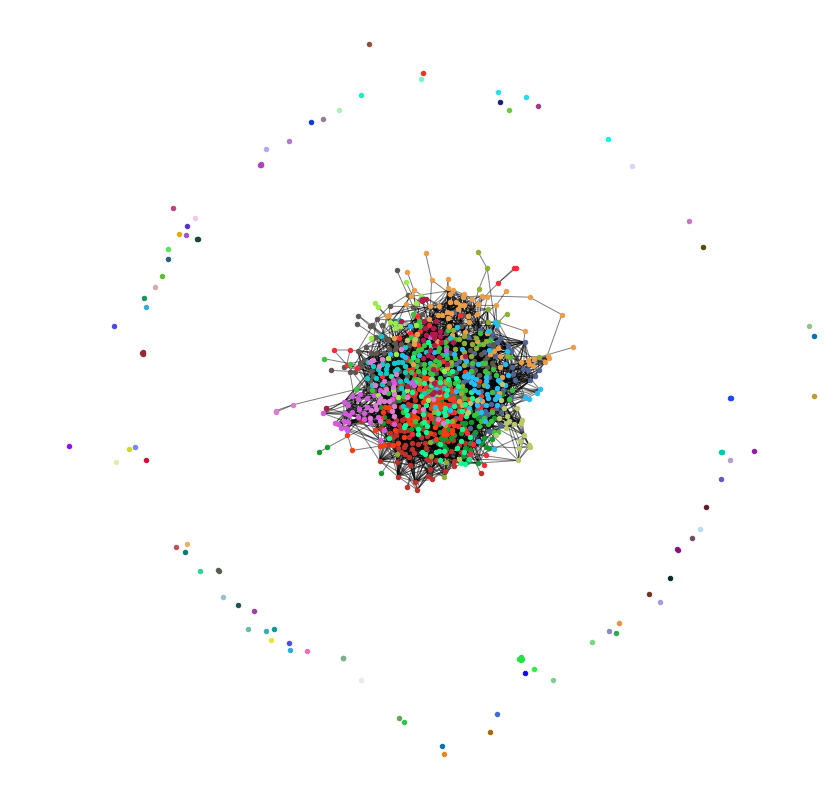

In [28]:
#first compute the best partition
partition = community.best_partition(G_und_m)

print(community.modularity(partition,G_und_m))
#drawing
plt.figure(figsize=(14,14))
plt.xlim(-1450,1450)
plt.ylim(-1450,1450)
plt.axis('off')
#Create figure:
count = 0.
for com in set(partition.values()) :
    count = count + 1.
    list_nodes = [nodes for nodes in partition.keys()
                                if partition[nodes] == com]
    nx.draw_networkx_nodes(G_und_m, positions_m, list_nodes, node_size = 20,
                                node_color = np.random.rand(1,4))


nx.draw_networkx_edges(G_und_m,positions_m, alpha=0.5)
plt.show()

In [29]:
#Print matrix for communities
c_matrix = []
for com in set(partition.values()):
    list_nodes = [nodes for nodes in partition.keys() if partition[nodes] == com]
    c_matrix.append([com,len(list_nodes)])

x = prettytable.PrettyTable(["Community:","Count"])

for n in c_matrix:    
    x.add_row([n[0], n[1]])

print(x)

+------------+-------+
| Community: | Count |
+------------+-------+
|     0      |   60  |
|     1      |   78  |
|     2      |   58  |
|     3      |   68  |
|     4      |   81  |
|     5      |   54  |
|     6      |   85  |
|     7      |   72  |
|     8      |   35  |
|     9      |   39  |
|     10     |   57  |
|     11     |   1   |
|     12     |   1   |
|     13     |   1   |
|     14     |   1   |
|     15     |   58  |
|     16     |   36  |
|     17     |   28  |
|     18     |   1   |
|     19     |   1   |
|     20     |   19  |
|     21     |   33  |
|     22     |   32  |
|     23     |   2   |
|     24     |   1   |
|     25     |   1   |
|     26     |   1   |
|     27     |   4   |
|     28     |   1   |
|     29     |   1   |
|     30     |   1   |
|     31     |   1   |
|     32     |   1   |
|     33     |   1   |
|     34     |   1   |
|     35     |   1   |
|     36     |   1   |
|     37     |   2   |
|     38     |   1   |
|     39     |   1   |
|     40   

Given the actor and movie analysis we can clearly see that quite a few popular movies are well connected such as the Prestige and the Dark Night Rises which are both highly acclaimed movies. Popular actors such as Hugh Jackman, Christian Bale and Brad Pitt are also among the most interconnected, indicating once more that there is likely a connecting between highly connected actors and popular movies.

In the above we explored the different aspects of movie interconnectivity, it seems as if there is a connection between ratings and earnings. As in very poorly rated movies do not have a chance of large scale earnings. On the other hand not every highly rated movie makes a good revenue. Overall the trends here are somewhat vague and does not provide us with alot of information for what makes a popular movie.

## Graph development over time.
In this section we explore the graphs development over time showing those these connections change over the years. In this case we will generate a network plot for each year. This effectively allows us to explore the network over the course of several years and how this changes, starting with movies:

Year: 2006


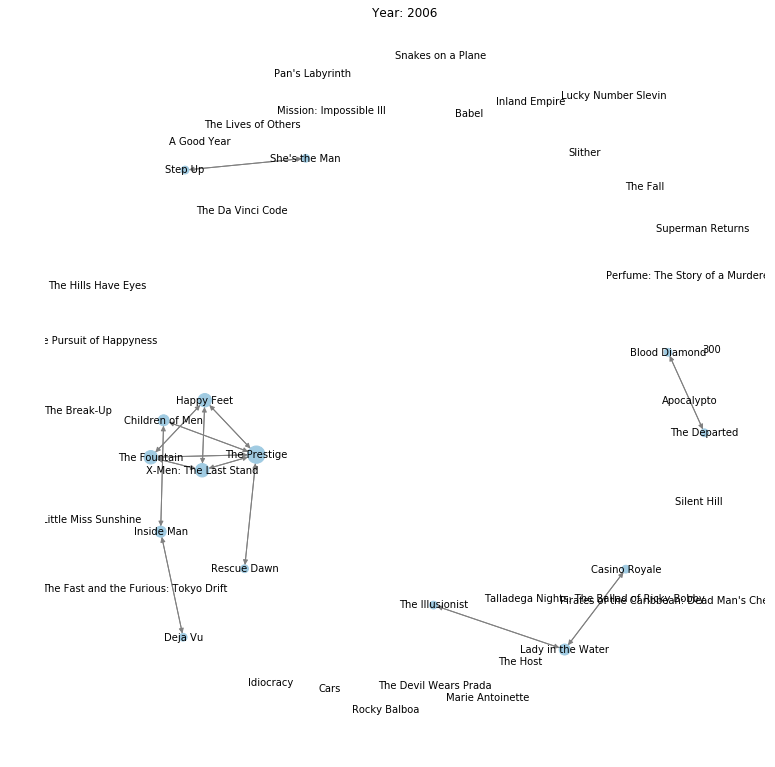

Degree distribution:


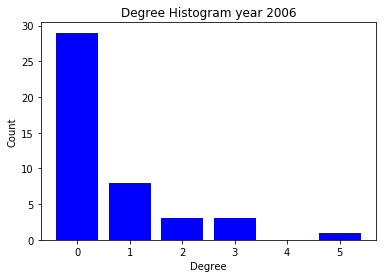

Year: 2007


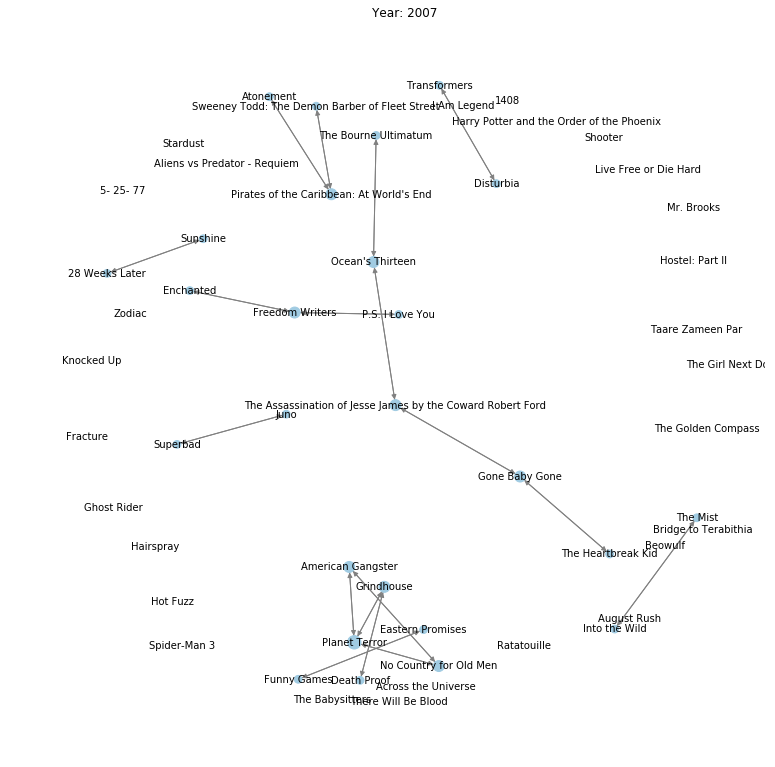

Degree distribution:


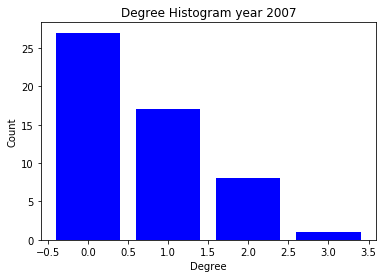

Year: 2008


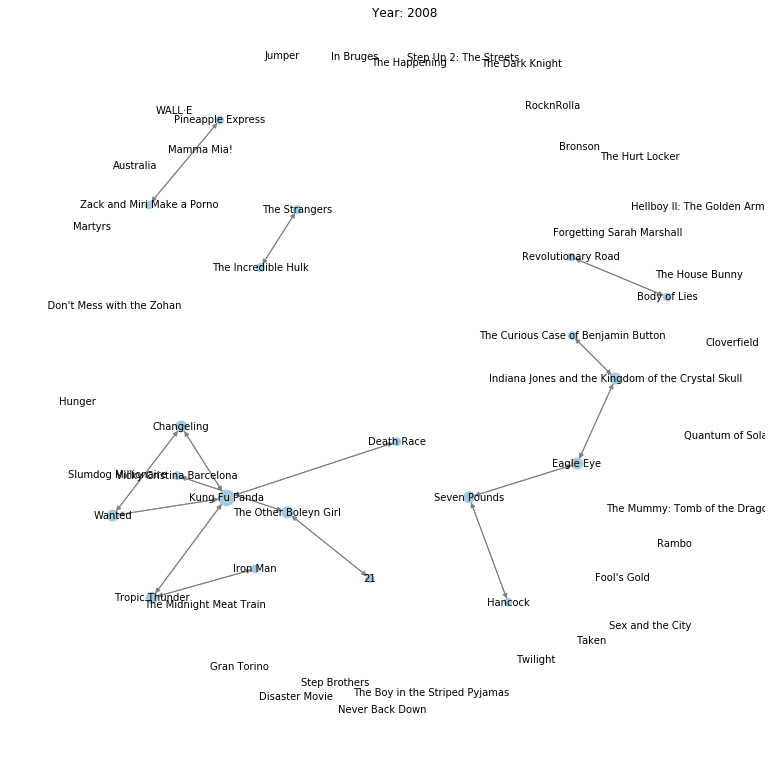

Degree distribution:


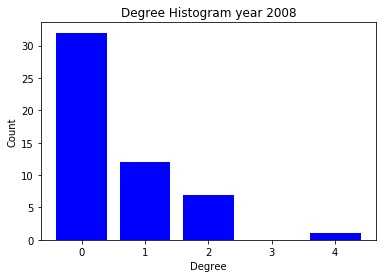

Year: 2009


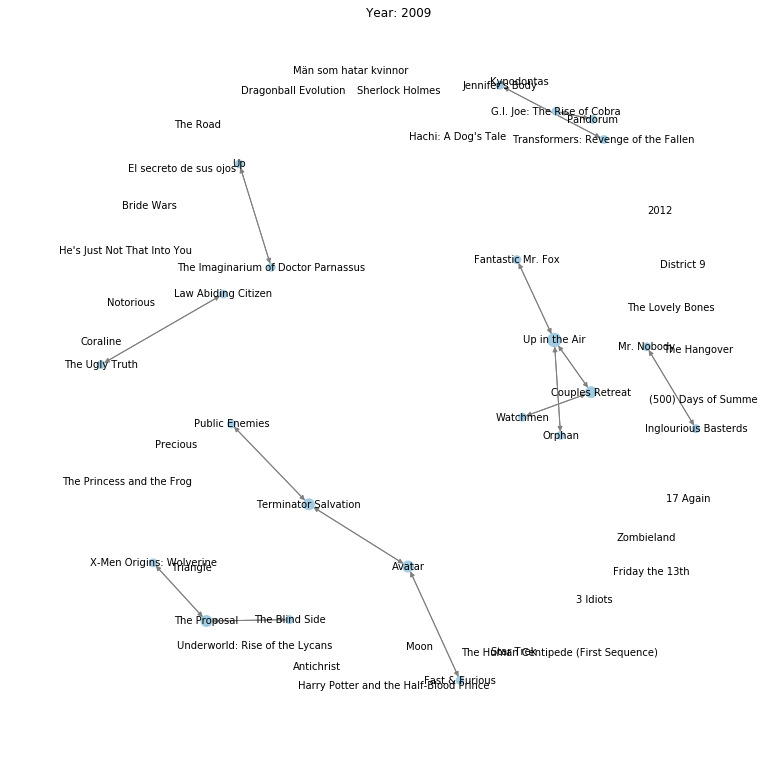

Degree distribution:


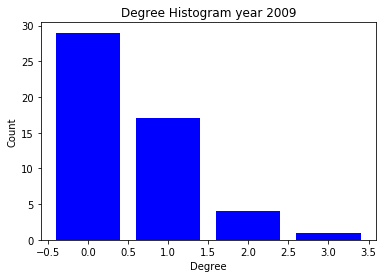

Year: 2010


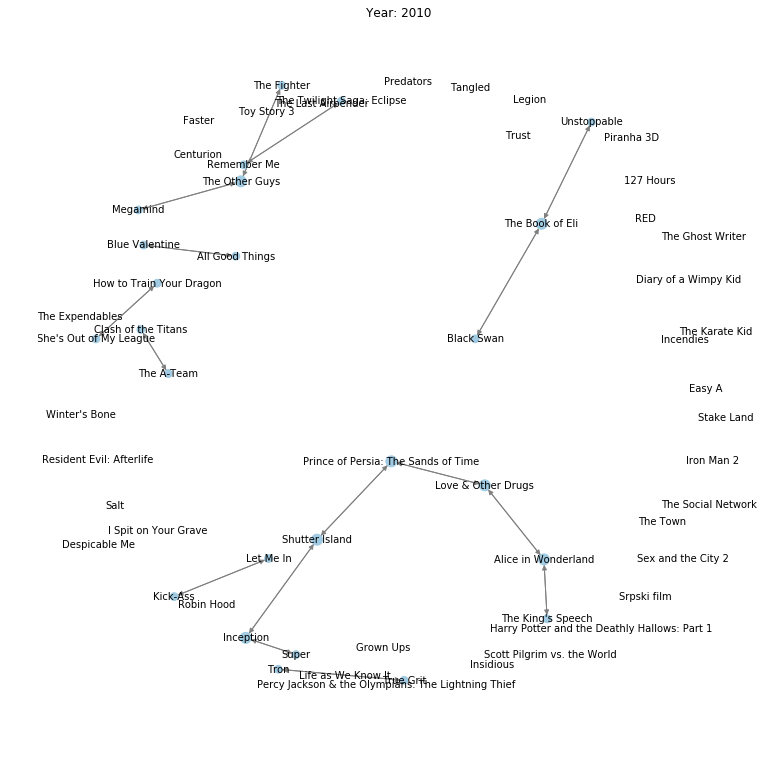

Degree distribution:


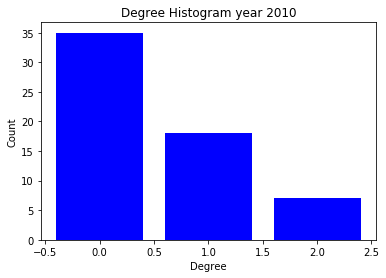

Year: 2011


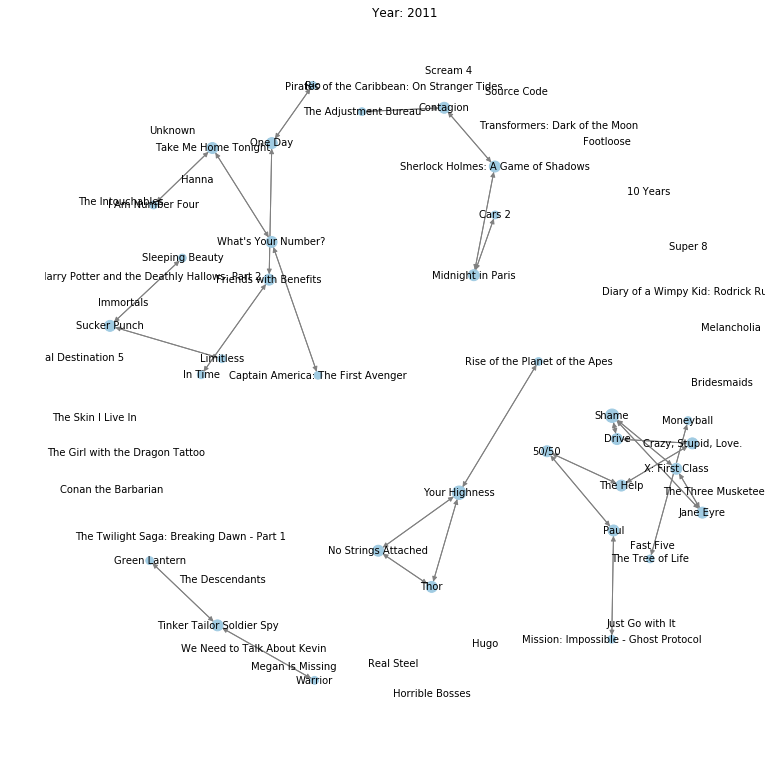

Degree distribution:


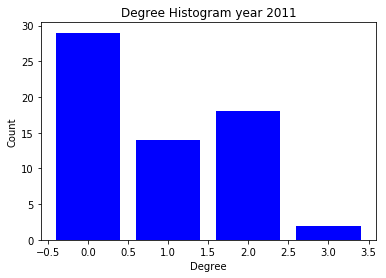

Year: 2012


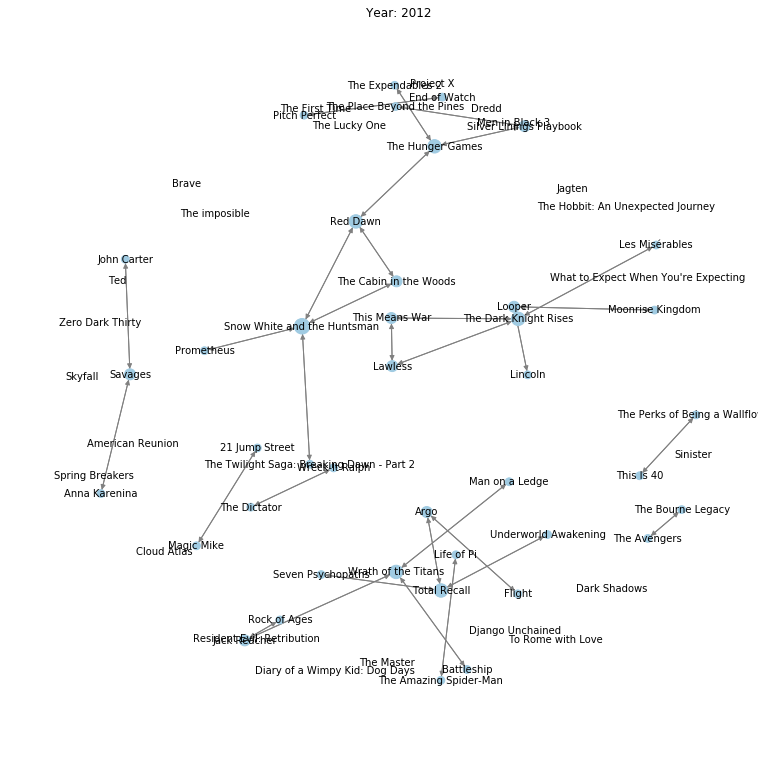

Degree distribution:


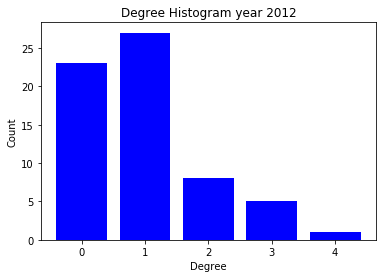

Year: 2013


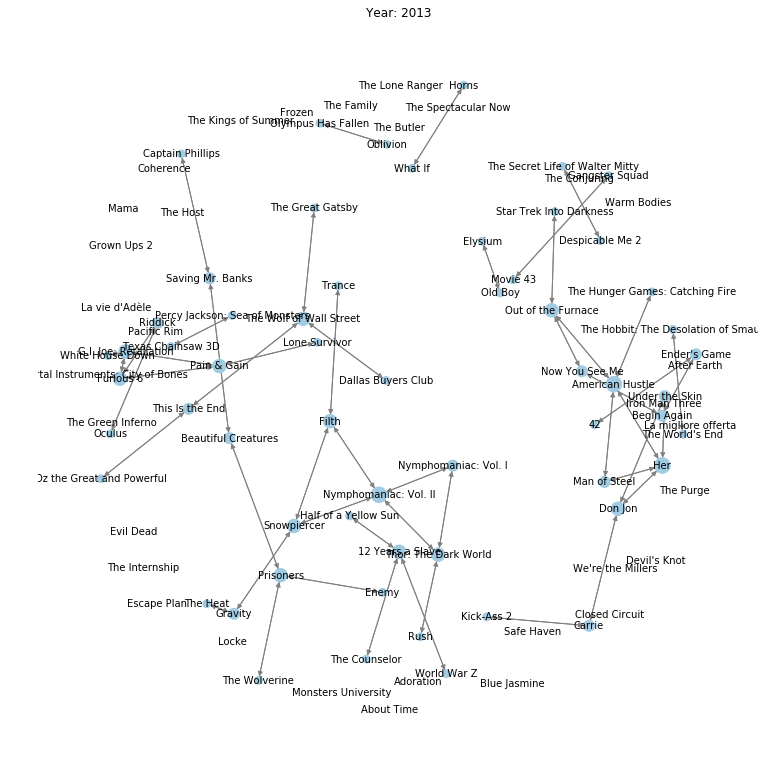

Degree distribution:


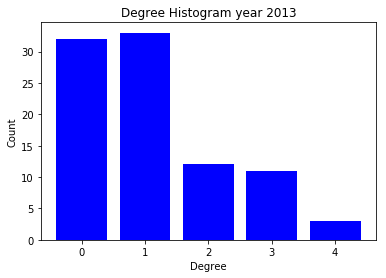

Year: 2014


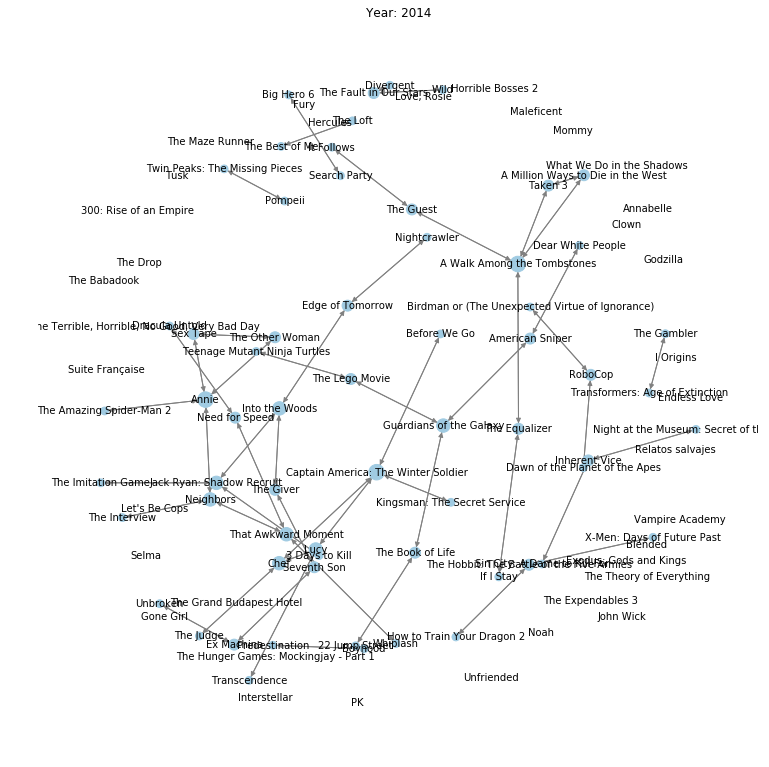

Degree distribution:


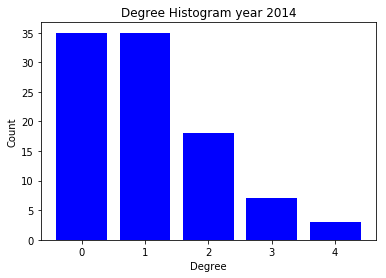

Year: 2015


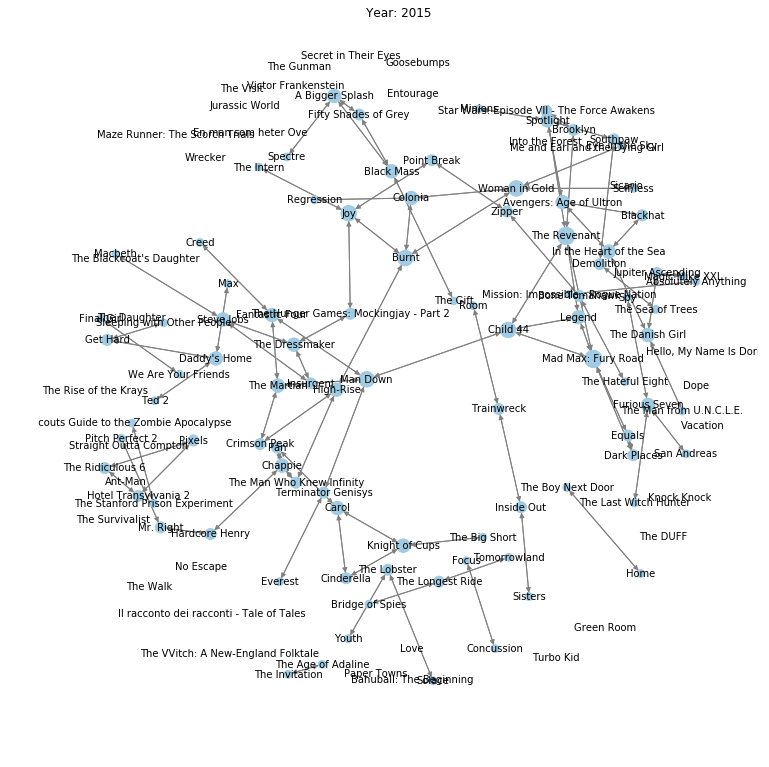

Degree distribution:


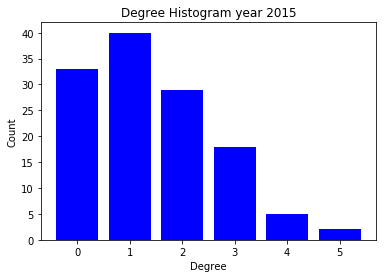

Year: 2016


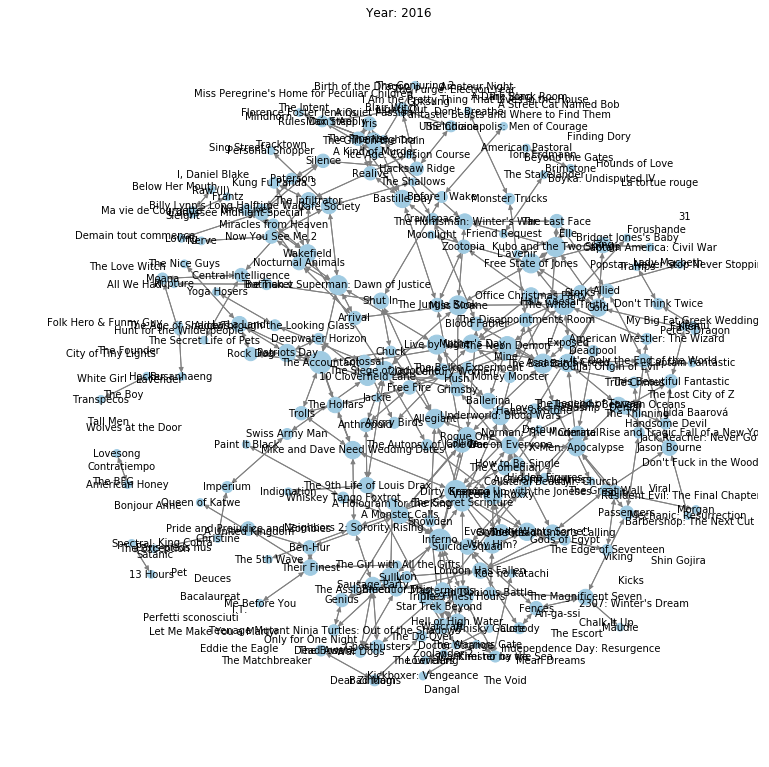

Degree distribution:


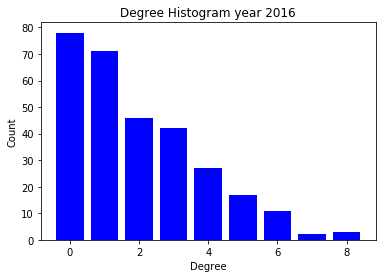

In [30]:
for i in range(2006,2017):    
    movie_nodes = []
    movie_links = []

    #First round of processing, data is sorted to movie and actor nodes respectively
    for index, row in moviedata.iterrows():
        if row.Year == i:
            movie_nodes.append(row.Title)

            for j in list(row.Actors.replace(", ",",").split(",")):
                nodes.append(j)
                movie_links.append((row.Title,j))
                for n in list(row.Actors.replace(", ",",").split(",")):
                    linklist.append((j,n))

    #If a movie shares an actor with another movie, this connects the movies 
    p_movie_links = []
    for k in movie_links:
        for j in movie_links:
            if(k[1] == j[1]):
                p_movie_links.append((k[0],j[0]))

    #Removes doublicates from actor links
    nodes = list(set(movie_nodes))
    G = nx.DiGraph()
    G.add_edges_from(p_movie_links)
    p_movie_links = [i for i in p_movie_links if i not in G.selfloop_edges()]
    G.remove_edges_from(G.selfloop_edges())
    G_und = G.to_undirected()
    
    print("Year: " + str(i))
    d=G.degree()
    plt.figure(1,figsize=(10,10))
    pos=nx.spring_layout(G,k=4/(G.number_of_nodes()**0.5))
    nx.draw(G, with_labels = True, node_size=[v[1] * 30 for v in d],font_size=10,pos=pos,edge_color='grey',node_color='#A0CBE2')
    plt.title("Year: " + str(i))
    plt.show()
    print("Degree distribution:")
    
    degree_sequence = sorted([d for n, d in G_und.degree()], reverse=True)  # degree sequence
    degreeCount = collections.Counter(degree_sequence)
    deg, cnt = zip(*degreeCount.items())

    fig, ax = plt.subplots()
    plt.bar(deg, cnt, width=0.80, color='b')

    plt.title("Degree Histogram year "+str(i))
    plt.ylabel("Count")
    plt.xlabel("Degree")
    plt.show()

Overall these visualizations provide us with an insight into the networks development over time. Showing how movies connect to one another through their actors per year, creating a timeline.

Further creating a series of network plots per year with actors and the most connected:

Year: 2006


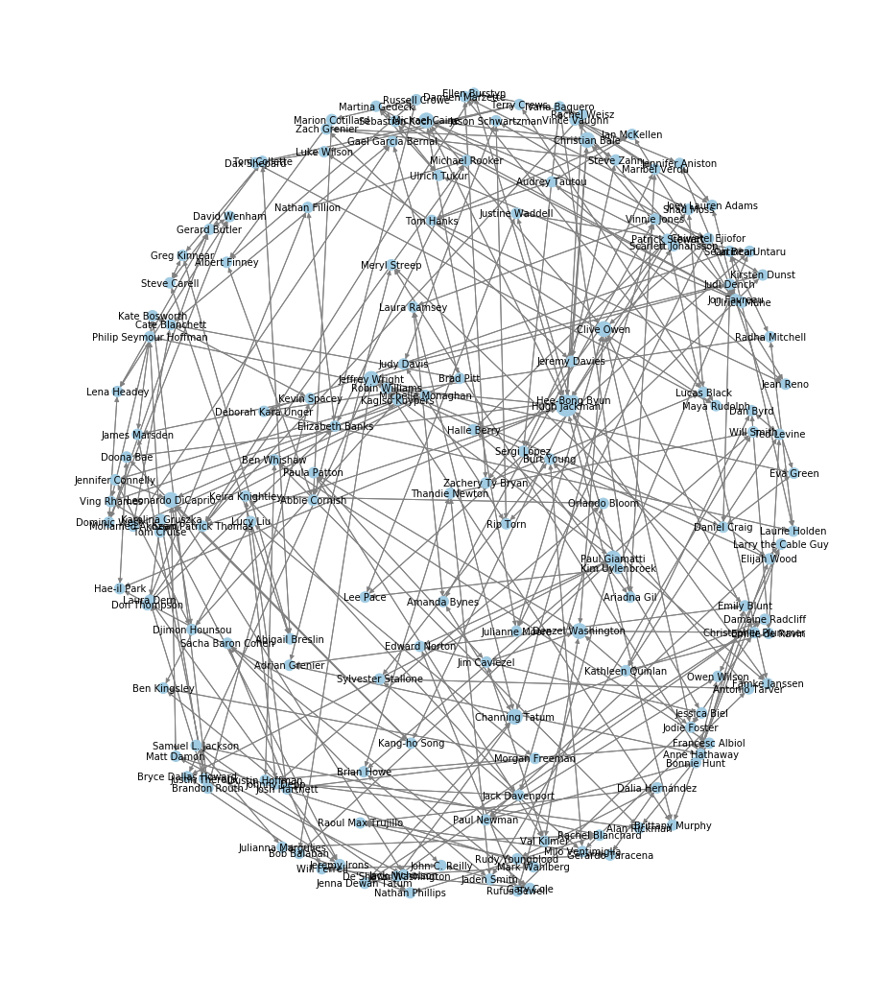

Degree distribution:
Highest degrees
[('Karolina Gruszka', 3), ('Christian Bale', 6), ('Michael Caine', 6), ('Leonardo DiCaprio', 6), ('Jeffrey Wright', 6), ('Clive Owen', 6), ('Channing Tatum', 6), ('Denzel Washington', 6), ('Paul Giamatti', 6), ('Hugh Jackman', 12)] 

Year: 2007


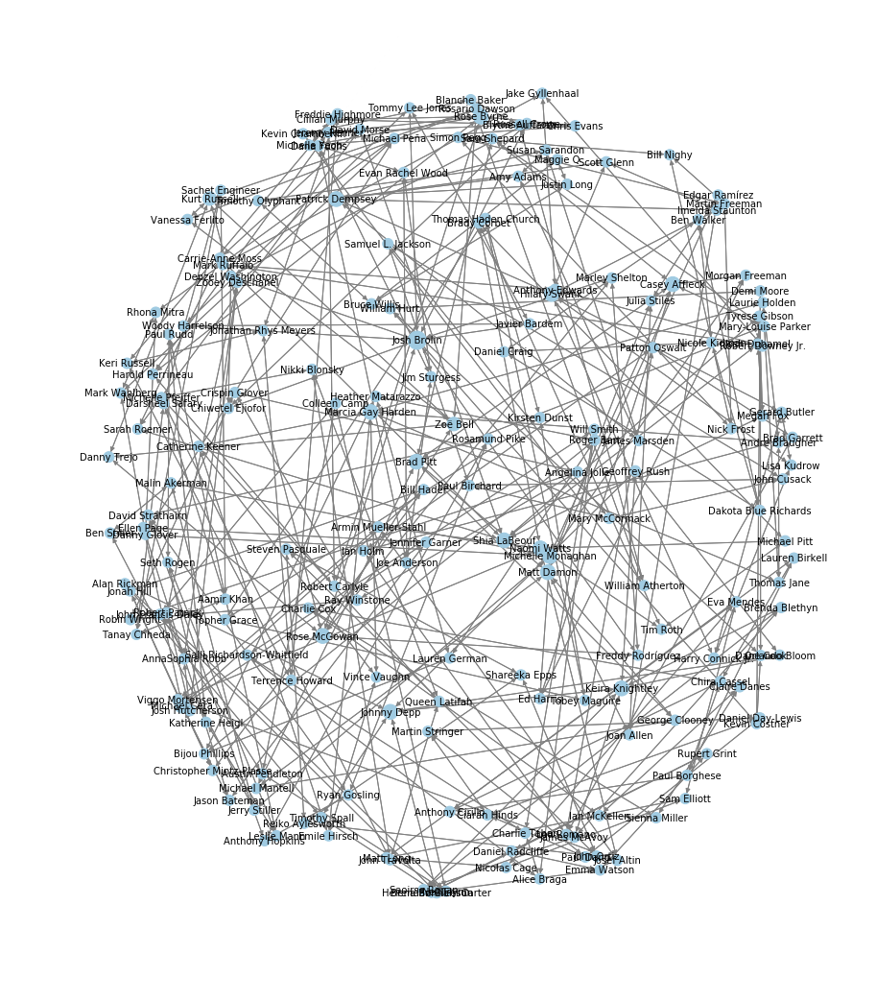

Degree distribution:
Highest degrees
[('Matt Damon', 6), ('Hilary Swank', 6), ('Patrick Dempsey', 6), ('Rose Byrne', 6), ('Brad Pitt', 6), ('Casey Affleck', 6), ('Naomi Watts', 6), ('Michelle Monaghan', 6), ('Rose McGowan', 6), ('Josh Brolin', 9)] 

Year: 2008


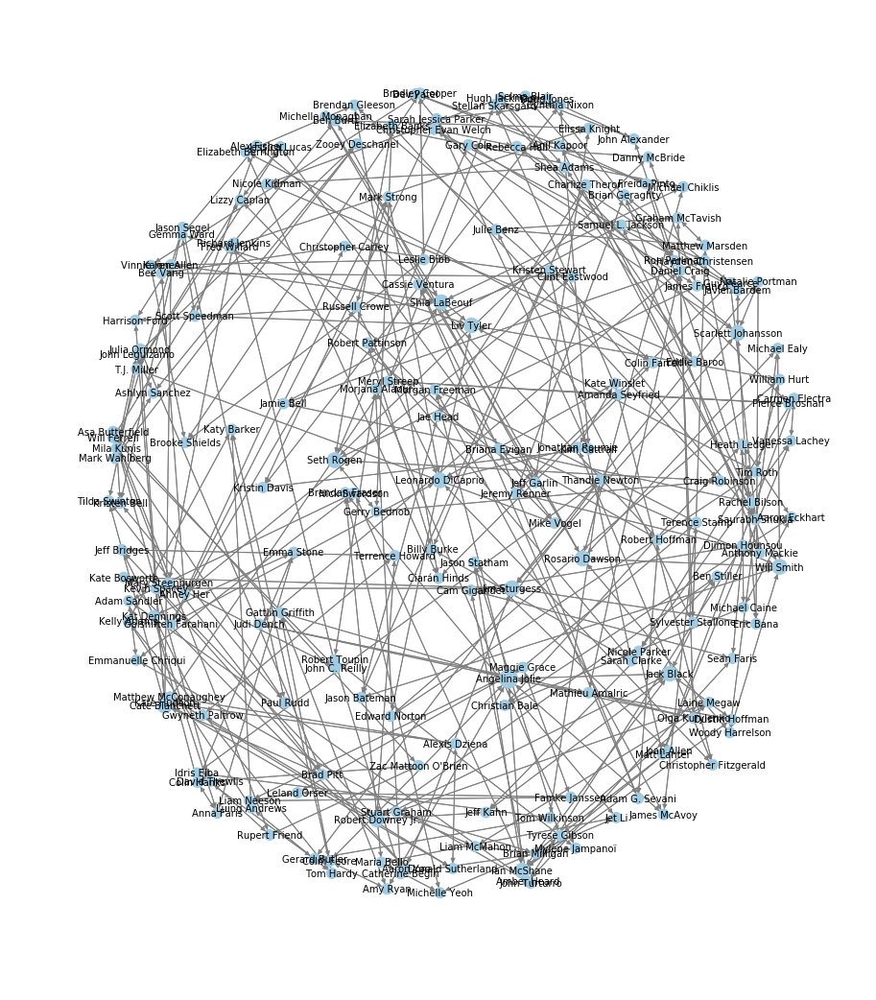

Degree distribution:
Highest degrees
[('Cate Blanchett', 6), ('Leonardo DiCaprio', 6), ('Seth Rogen', 6), ('Will Smith', 6), ('Rosario Dawson', 6), ('Shia LaBeouf', 6), ('Jim Sturgess', 6), ('Scarlett Johansson', 6), ('Ian McShane', 6), ('Angelina Jolie', 9)] 

Year: 2009


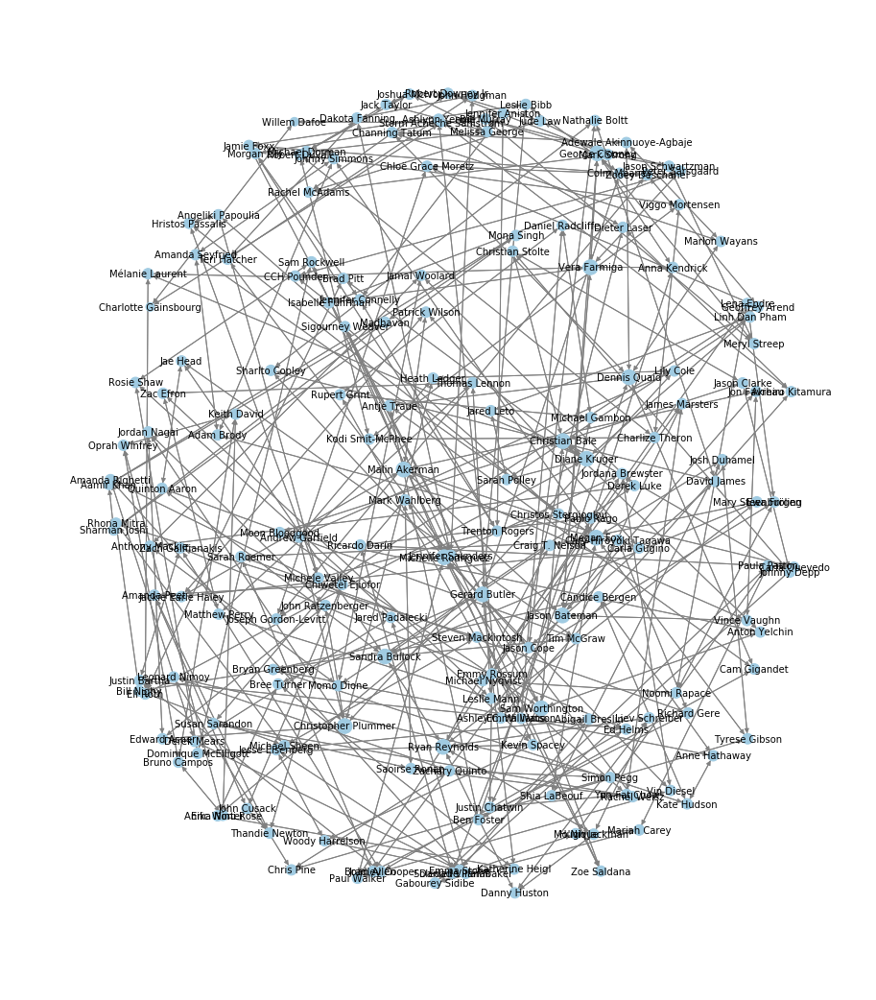

Degree distribution:
Highest degrees
[('Ryan Reynolds', 6), ('Sandra Bullock', 6), ('Megan Fox', 6), ('Jason Bateman', 6), ('Dennis Quaid', 6), ('Gerard Butler', 6), ('Christopher Plummer', 6), ('Christian Bale', 6), ('Vera Farmiga', 6), ('George Clooney', 6)] 

Year: 2010


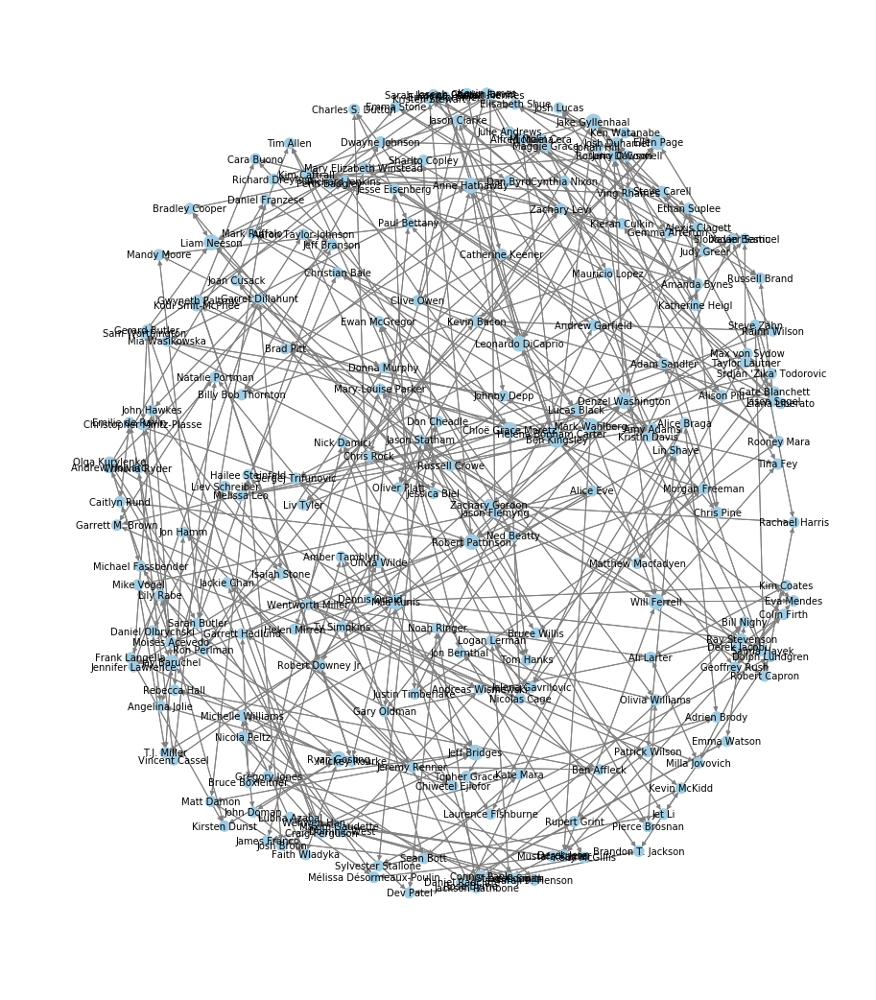

Degree distribution:
Highest degrees
[('Ryan Gosling', 6), ('Will Ferrell', 6), ('Mark Wahlberg', 6), ('Denzel Washington', 6), ('Helena Bonham Carter', 6), ('Anne Hathaway', 6), ('Liam Neeson', 6), ('Jeff Bridges', 6), ('Jake Gyllenhaal', 6), ('Robert Pattinson', 6)] 

Year: 2011


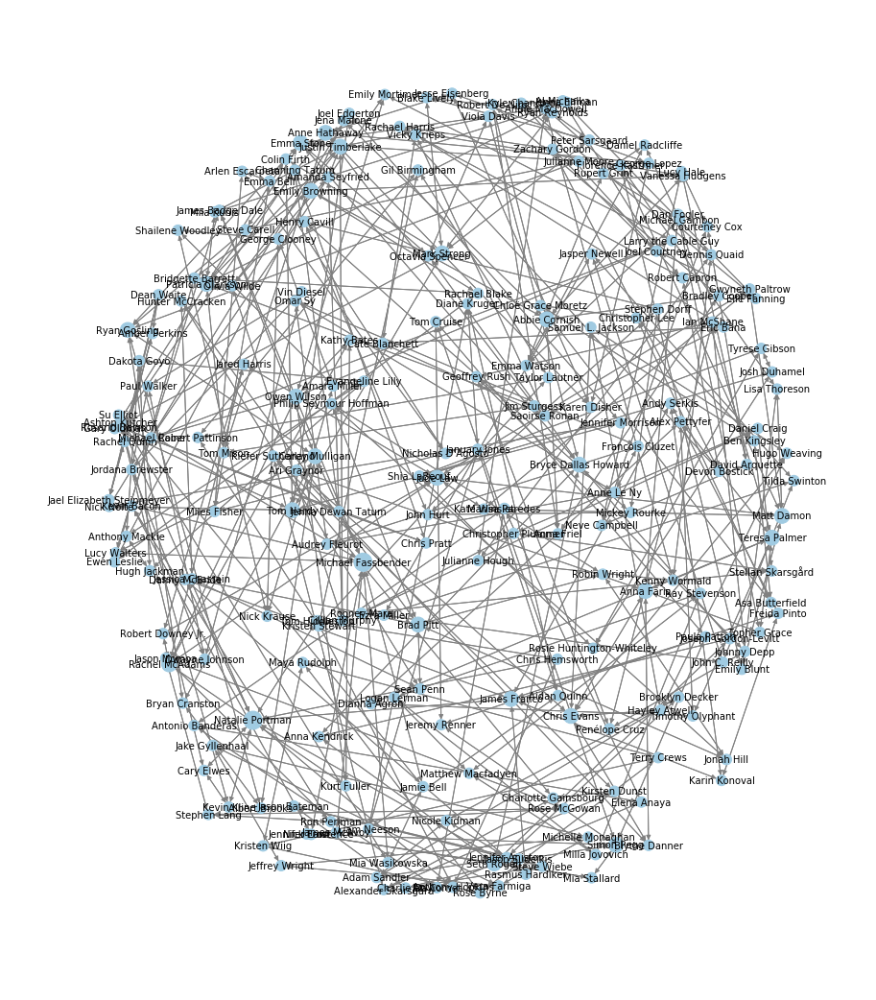

Degree distribution:
Highest degrees
[('Jude Law', 6), ('Brad Pitt', 6), ('Mark Strong', 6), ('Matt Damon', 6), ('Patricia Clarkson', 6), ('Seth Rogen', 6), ('Anne Hathaway', 6), ('Anna Faris', 6), ('Natalie Portman', 9), ('Michael Fassbender', 9)] 

Year: 2012


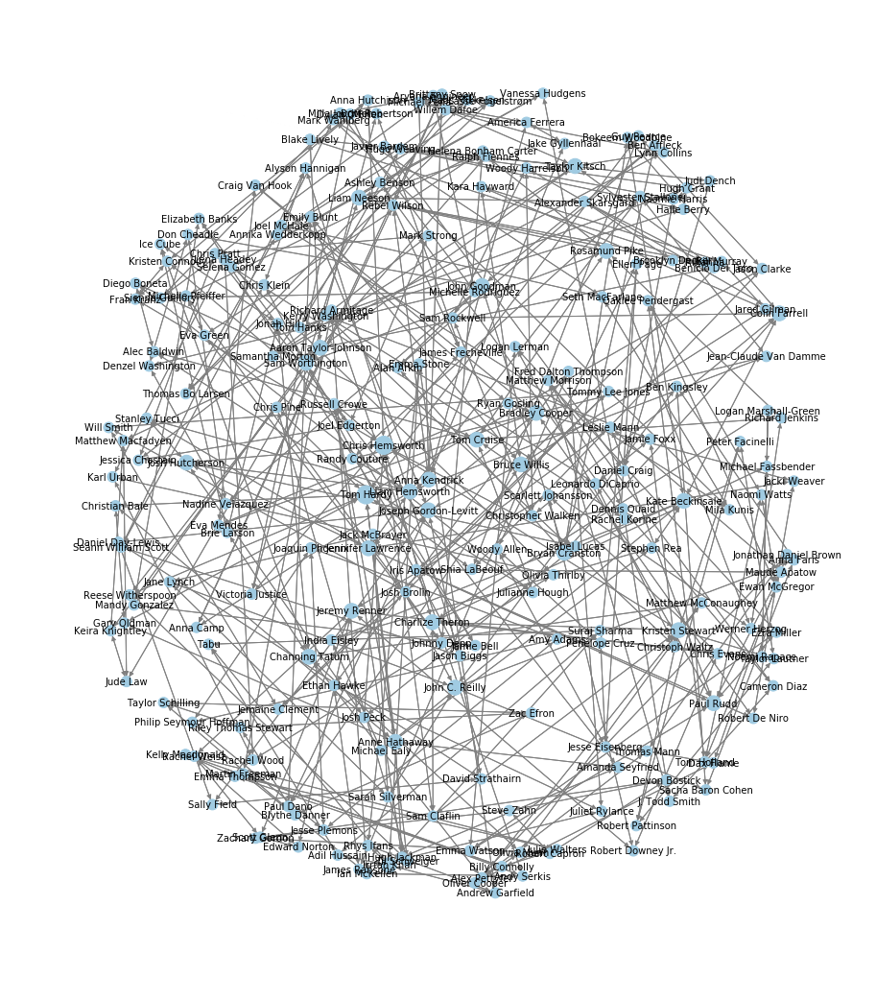

Degree distribution:
Highest degrees
[('John Goodman', 6), ('Aaron Taylor-Johnson', 6), ('Tom Cruise', 6), ('Rosamund Pike', 6), ('John C. Reilly', 6), ('Kate Beckinsale', 6), ('Colin Farrell', 6), ('Sam Worthington', 6), ('Tom Hardy', 9), ('Chris Hemsworth', 9)] 

Year: 2013


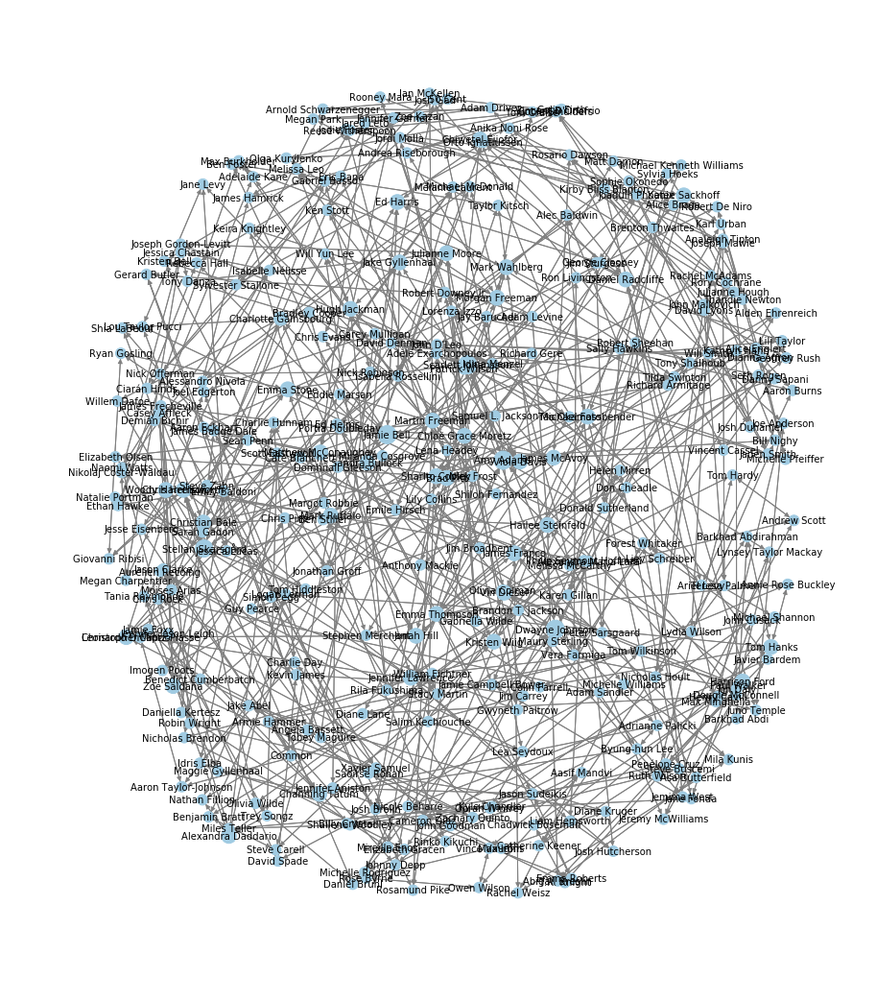

Degree distribution:
Highest degrees
[('Katee Sackhoff', 6), ('Harrison Ford', 6), ('Hailee Steinfeld', 6), ('Tom Hanks', 6), ('Daniel Radcliffe', 6), ('Stellan Skarsgård', 8), ('Dwayne Johnson', 9), ('Amy Adams', 9), ('Scarlett Johansson', 9), ('Jamie Bell', 9)] 

Year: 2014


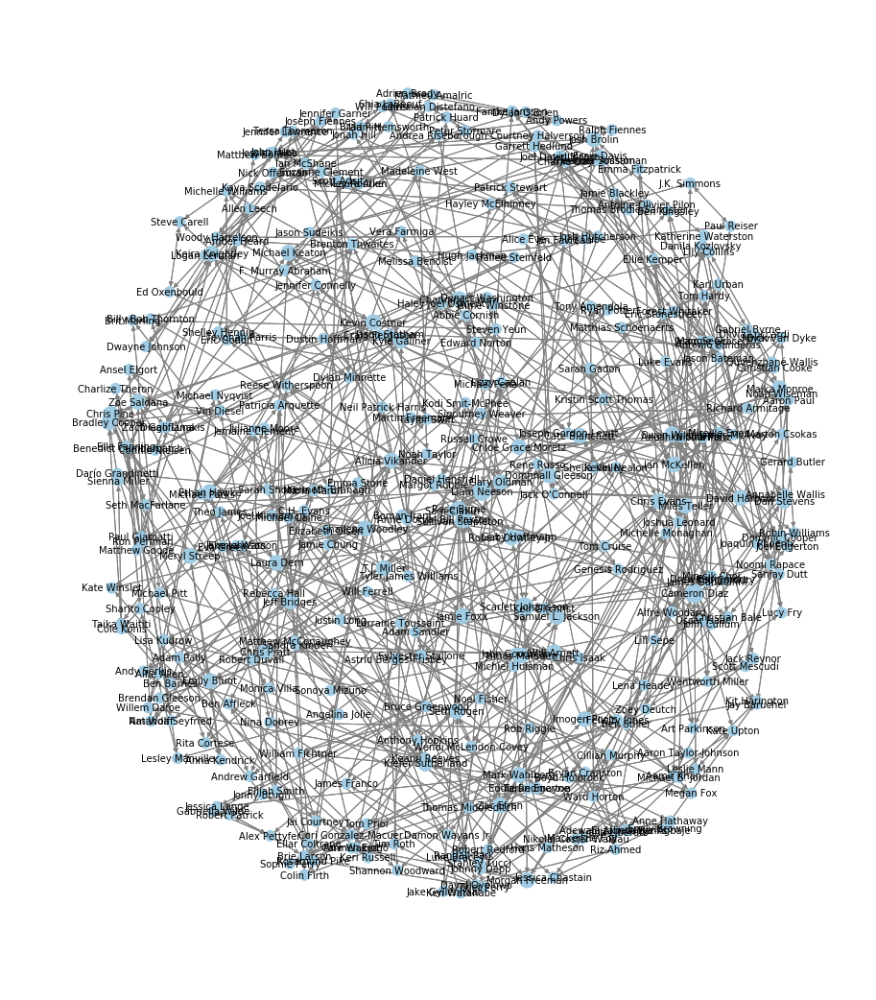

Degree distribution:
Highest degrees
[('Imogen Poots', 6), ('Seth Rogen', 6), ('Robert Downey Jr.', 6), ('Rose Byrne', 6), ('Zac Efron', 6), ('Dan Stevens', 6), ('Kevin Costner', 6), ('Scarlett Johansson', 9), ('Cameron Diaz', 9), ('Liam Neeson', 9)] 

Year: 2015


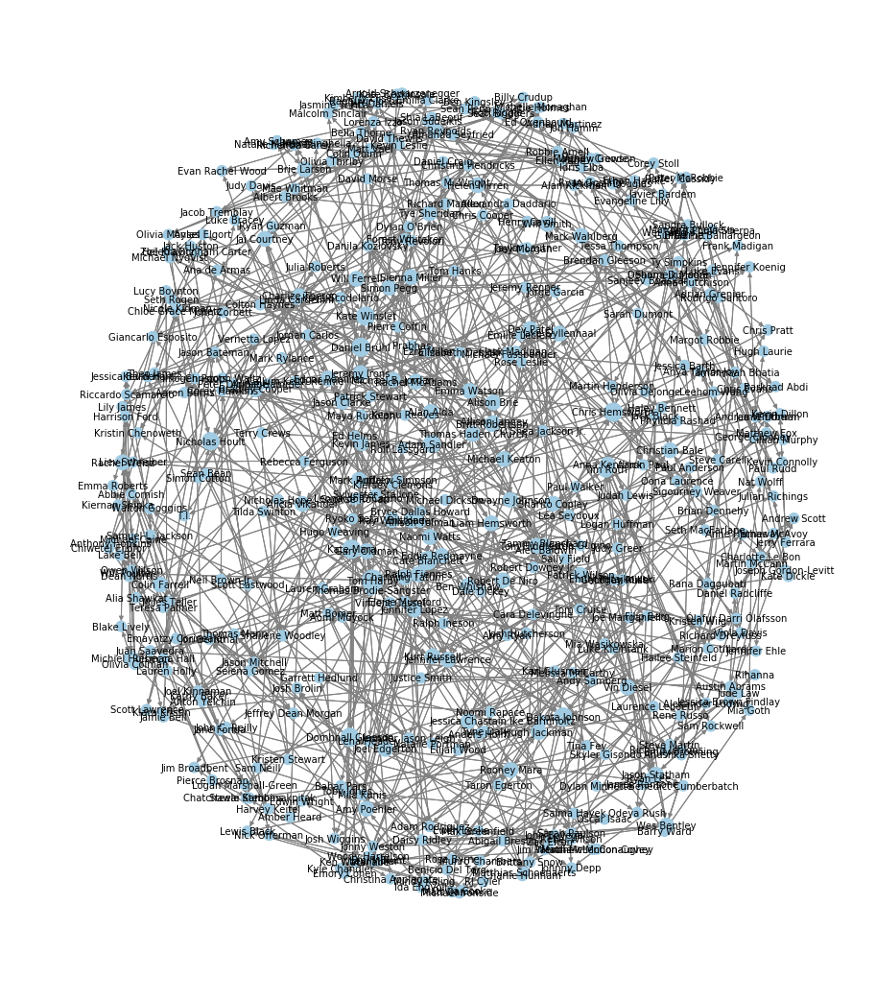

Degree distribution:
Highest degrees
[('Nicholas Hoult', 8), ('Adam Sandler', 8), ('Domhnall Gleeson', 9), ('Dakota Johnson', 9), ('Chris Hemsworth', 9), ('Kate Mara', 9), ('Daniel Brühl', 9), ('Cate Blanchett', 9), ('Kate Winslet', 9), ('Tom Hardy', 12)] 

Year: 2016


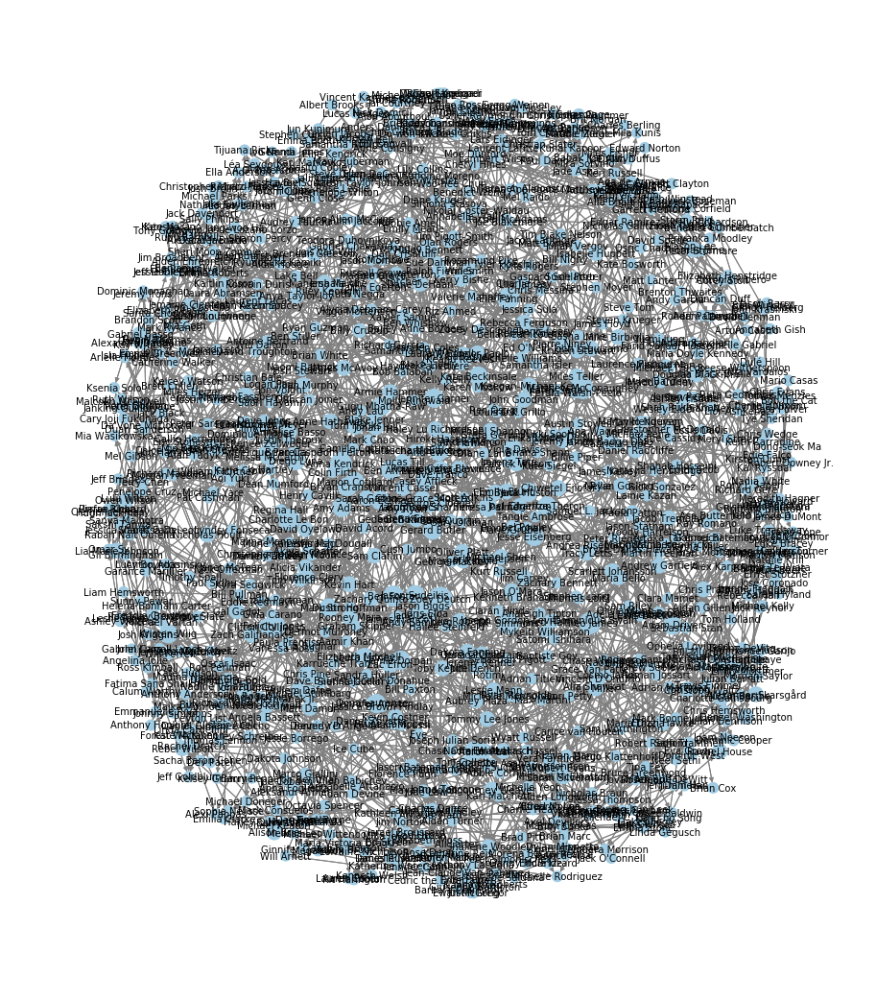

Degree distribution:
Highest degrees
[('Ben Foster', 11), ('Matthew McConaughey', 12), ('J.K. Simmons', 12), ('Felicity Jones', 12), ('Anna Kendrick', 12), ('Theo James', 12), ('Charlotte Le Bon', 12), ('Elle Fanning', 12), ('Keanu Reeves', 12), ('Zoey Deutch', 15)] 



In [31]:
#First round of processing, data is sorted to movie and actor nodes respectively

def sort_print_top3(dictionary, g_und):
    print(sorted([(i[0],dictionary[i[0]]) for i in g_und.nodes(data = True)],key = lambda x:x[1])[-10:],"\n")

for i in range(2006,2017):    
    actor_nodes = []
    actor_links = []

    #First round of processing, data is sorted to movie and actor nodes respectively
    for index, row in moviedata.iterrows():
        if row.Year == i:
            actor_nodes.append(row.Title)
            for j in list(row.Actors.replace(", ",",").split(",")):
                nodes.append(j)
                for n in list(row.Actors.replace(", ",",").split(",")):
                    actor_links.append((j,n))

    #Removes doublicates from actor links
    nodes = list(set(actor_nodes))
    G = nx.DiGraph()
    G.add_edges_from(actor_links)
    p_movie_links = [i for i in actor_links if i not in G.selfloop_edges()]
    G.remove_edges_from(G.selfloop_edges())
    G_und = G.to_undirected()
    
    print("Year: " + str(i))
    d=G.degree()
    plt.figure(1,figsize=(12,14))
    pos=nx.spring_layout(G,k=12/(G.number_of_nodes()**0.5))
    nx.draw(G, with_labels = True, node_size=[v[1] * 20 for v in d],font_size=10,pos=pos,edge_color='grey',node_color='#A0CBE2')
    plt.show()
    print("Degree distribution:")

    und_degree = dict(G_und.degree())
    print("Highest degrees")
    sort_print_top3(und_degree,G_und)

Once more we see that most central to this movie network is famous actors. These plots also allows us to trace how active actors are per year. This also shows that several actors are extremely popular, accross years and that likely, recruiting these actors are an attempt to popularize movies.

This section provided us with a timeline based visualization for how the network evolved over time. It highlights actor and movie connectivity over the years and shows that highly rated actors are centralised in the networks over the years.

### Wikipedia Scraping, Wordcloud and Sentiment analysis

In this section, we are collecting data from Wikipedia based on the movie dataset. We are looking at text describing the plot and the cast of the movies. For the plot section we are dividing the movies in 5 groups based on rating and for the cast section we are dividing the movies into two categories, popular and unpopular movies, also based on their ratings. We will construct Wordclouds as a result of the plot and cast data from Wikipedia. We will also do a sentiment analysis on the data.

**Collect all plot sections from the respective Wikipedia pages of movies with rating less than 2**

In [32]:

import wikipedia
movies = pd.read_csv('moviedata.csv')
#Look at movies with rating less than 2 only
movie_0_2_plots=[]
for index, row in movies.iterrows():
    
    film=movies.Title[index]+' ('+str(movies.Year[index])+' film)'
    if movies.Rating[index]<2:
        
        try:
            # get the section of a page. In this case the Plot description 
            # try finding page with movie name, the word film and production year
            section = wikipedia.WikipediaPage(film).section('Plot')

            # that will return fairly clean text, but the next line of code
            # will help clean that up.
            section = section.replace('\n','').replace("\'","")
            movie_0_2_plots.append(section)

        except:
            try: 
                # try finding page with movie name and the word film
                film=movies.Title[index]+' (film)'
                section = wikipedia.WikipediaPage(film).section('Plot')

                section = section.replace('\n','').replace("\'","")
                movie_0_2_plots.append(section)

                #Skip movie if it doesnt findt it 

            except:   
                try: 
                    # try finding page with only movie name
                    film=movies.Title[index]
                    section = wikipedia.WikipediaPage(film).section('Plot')

                    section = section.replace('\n','').replace("\'","")
                    movie_0_2_plots.append(section)

                    #Skip movie if it doesnt findt it 
                except:
                    try: 
                        film=movies.Title[index]+' ('+str(movies.Year[index])+' American film)'
                        section = wikipedia.WikipediaPage(film).section('Plot')

                        section = section.replace('\n','').replace("\'","")
                        movie_0_2_plots.append(section)

                    #Skip movie if it doesnt findt it 
                    except:
                        pass


**Collect all plot sections from the respective Wikipedia pages of movies with rating between 2 and 4**

In [33]:
#Look at movies with rating between 2 and 4 only
movie_2_4_plots=[]
for index, row in movies.iterrows():
    
    film=movies.Title[index]+' ('+str(movies.Year[index])+' film)'
    if 2<movies.Rating[index]<4:
        
        try:
            # get the section of a page. In this case the Plot description 
            section = wikipedia.WikipediaPage(film).section('Plot')

            # that will return fairly clean text, but the next line of code
            # will help clean that up.
            section = section.replace('\n','').replace("\'","")
            movie_2_4_plots.append(section)

        except:
            try: 
                film=movies.Title[index]+' (film)'
                section = wikipedia.WikipediaPage(film).section('Plot')

                section = section.replace('\n','').replace("\'","")
                movie_2_4_plots.append(section)

                #Skip movie if it doesnt findt it 

            except:   
                try: 
                    film=movies.Title[index]
                    section = wikipedia.WikipediaPage(film).section('Plot')

                    section = section.replace('\n','').replace("\'","")
                    movie_2_4_plots.append(section)

                    #Skip movie if it doesnt findt it 
                except:
                    try: 
                        film=movies.Title[index]+' ('+str(movies.Year[index])+' American film)'
                        section = wikipedia.WikipediaPage(film).section('Plot')

                        section = section.replace('\n','').replace("\'","")
                        movie_2_4_plots.append(section)

                    #Skip movie if it doesnt findt it 
                    except:
                        pass

C:\Users\danma\Anaconda3\lib\site-packages\bs4\__init__.py:181: UserWarning: No parser was explicitly specified, so I'm using the best available HTML parser for this system ("lxml"). This usually isn't a problem, but if you run this code on another system, or in a different virtual environment, it may use a different parser and behave differently.

The code that caused this warning is on line 193 of the file C:\Users\danma\Anaconda3\lib\runpy.py. To get rid of this warning, change code that looks like this:

 BeautifulSoup(YOUR_MARKUP})

to this:

 BeautifulSoup(YOUR_MARKUP, "lxml")

  markup_type=markup_type))


**Collect all plot sections from the respective Wikipedia pages of movies with rating between 4 and 6**

In [34]:
#Look at movies with rating between 4 and 6 only
movie_4_6_plots=[]
for index, row in movies.iterrows():
    
    film=movies.Title[index]+' ('+str(movies.Year[index])+' film)'
    if 4<movies.Rating[index]<6:
        
        try:
            # get the section of a page. In this case the Plot description 
            section = wikipedia.WikipediaPage(film).section('Plot')

            # that will return fairly clean text, but the next line of code
            # will help clean that up.
            section = section.replace('\n','').replace("\'","")
            movie_4_6_plots.append(section)

        except:
            try: 
                film=movies.Title[index]+' (film)'
                section = wikipedia.WikipediaPage(film).section('Plot')

                section = section.replace('\n','').replace("\'","")
                movie_4_6_plots.append(section)

                #Skip movie if it doesnt findt it 

            except:   
                try: 
                    film=movies.Title[index]
                    section = wikipedia.WikipediaPage(film).section('Plot')

                    section = section.replace('\n','').replace("\'","")
                    movie_4_6_plots.append(section)

                    #Skip movie if it doesnt findt it 
                except:
                    try: 
                        film=movies.Title[index]+' ('+str(movies.Year[index])+' American film)'
                        section = wikipedia.WikipediaPage(film).section('Plot')

                        section = section.replace('\n','').replace("\'","")
                        movie_4_6_plots.append(section)

                    #Skip movie if it doesnt findt it 
                    except:
                        pass


C:\Users\danma\Anaconda3\lib\site-packages\bs4\__init__.py:181: UserWarning: No parser was explicitly specified, so I'm using the best available HTML parser for this system ("lxml"). This usually isn't a problem, but if you run this code on another system, or in a different virtual environment, it may use a different parser and behave differently.

The code that caused this warning is on line 193 of the file C:\Users\danma\Anaconda3\lib\runpy.py. To get rid of this warning, change code that looks like this:

 BeautifulSoup(YOUR_MARKUP})

to this:

 BeautifulSoup(YOUR_MARKUP, "lxml")

  markup_type=markup_type))


**Collect all plot sections from the respective Wikipedia pages of movies with rating between 6 and 8**

In [35]:
#Look at movies with rating between 6 and 8 only
movie_6_8_plots=[]
for index, row in movies.iterrows():
    
    film=movies.Title[index]+' ('+str(movies.Year[index])+' film)'
    if 6<movies.Rating[index]<8:
        
        try:
            # get the section of a page. In this case the Plot description 
            section = wikipedia.WikipediaPage(film).section('Plot')

            # that will return fairly clean text, but the next line of code
            # will help clean that up.
            section = section.replace('\n','').replace("\'","")
            movie_6_8_plots.append(section)

        except:
            try: 
                film=movies.Title[index]+' (film)'
                section = wikipedia.WikipediaPage(film).section('Plot')

                section = section.replace('\n','').replace("\'","")
                movie_6_8_plots.append(section)

                #Skip movie if it doesnt findt it 

            except:   
                try: 
                    film=movies.Title[index]
                    section = wikipedia.WikipediaPage(film).section('Plot')

                    section = section.replace('\n','').replace("\'","")
                    movie_6_8_plots.append(section)

                    #Skip movie if it doesnt findt it 
                except:
                    try: 
                        film=movies.Title[index]+' ('+str(movies.Year[index])+' American film)'
                        section = wikipedia.WikipediaPage(film).section('Plot')

                        section = section.replace('\n','').replace("\'","")
                        movie_6_8_plots.append(section)

                    #Skip movie if it doesnt findt it 
                    except:
                        pass


C:\Users\danma\Anaconda3\lib\site-packages\bs4\__init__.py:181: UserWarning: No parser was explicitly specified, so I'm using the best available HTML parser for this system ("lxml"). This usually isn't a problem, but if you run this code on another system, or in a different virtual environment, it may use a different parser and behave differently.

The code that caused this warning is on line 193 of the file C:\Users\danma\Anaconda3\lib\runpy.py. To get rid of this warning, change code that looks like this:

 BeautifulSoup(YOUR_MARKUP})

to this:

 BeautifulSoup(YOUR_MARKUP, "lxml")

  markup_type=markup_type))


**Collect all plot sections from the respective Wikipedia pages of movies with rating between 8 and 10**

In [36]:
#Look at movies with rating between 8 and 10 only
movie_8_10_plots=[]
for index, row in movies.iterrows():
    
    film=movies.Title[index]+' ('+str(movies.Year[index])+' film)'
    if 8<movies.Rating[index]:
        
        try:
            # get the section of a page. In this case the Plot description 
            section = wikipedia.WikipediaPage(film).section('Plot')

            # that will return fairly clean text, but the next line of code
            # will help clean that up.
            section = section.replace('\n','').replace("\'","")
            movie_8_10_plots.append(section)

        except:
            try: 
                film=movies.Title[index]+' (film)'
                section = wikipedia.WikipediaPage(film).section('Plot')

                section = section.replace('\n','').replace("\'","")
                movie_8_10_plots.append(section)

                #Skip movie if it doesnt findt it 

            except:   
                try: 
                    film=movies.Title[index]
                    section = wikipedia.WikipediaPage(film).section('Plot')

                    section = section.replace('\n','').replace("\'","")
                    movie_8_10_plots.append(section)

                    #Skip movie if it doesnt findt it 
                except:
                    try: 
                        film=movies.Title[index]+' ('+str(movies.Year[index])+' American film)'
                        section = wikipedia.WikipediaPage(film).section('Plot')

                        section = section.replace('\n','').replace("\'","")
                        movie_8_10_plots.append(section)

                    #Skip movie if it doesnt findt it 
                    except:
                        pass


**Wordcloud on plots from 0-2 movies (it's only one movie!)**

3934
3897
3897
395
276


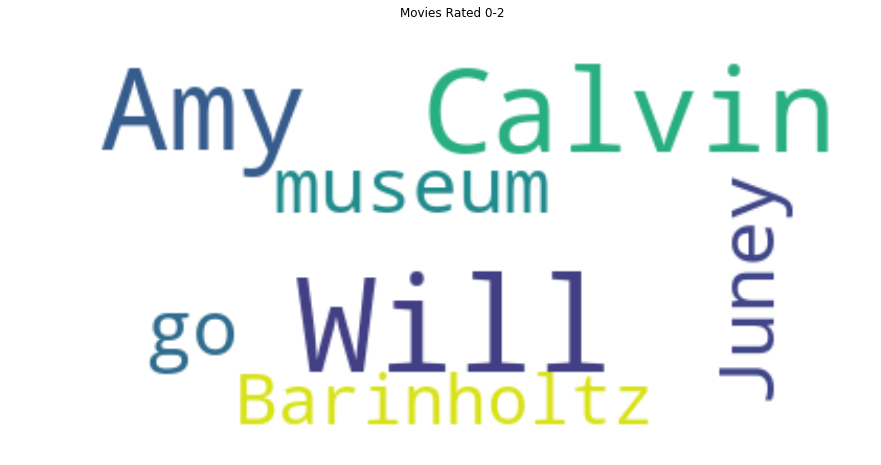

In [37]:
#Convert the plot sections from a list of strings to one string
movie_0_2_plots1="".join(movie_0_2_plots)

#processing
from nltk.tokenize import RegexpTokenizer
from nltk.corpus import stopwords
from nltk import word_tokenize
#Tokenization & remove all "."s and \d's
print(len(movie_0_2_plots1))
#Remove newlines
movie_0_2_plots1= movie_0_2_plots1.replace('\\n'," ").replace('.','')
print(len(movie_0_2_plots1))

tokenizer = RegexpTokenizer(r'\w+')
movie_0_2_plots1_tokens = tokenizer.tokenize(movie_0_2_plots1)
print(len(movie_0_2_plots1))

#Remove stop words & lower
stopset = set(stopwords.words('english'))
movie_0_2_plots1_tokens = [w for w in movie_0_2_plots1_tokens if not w in stopset]

print(len(movie_0_2_plots1_tokens))
print(len(set(movie_0_2_plots1_tokens)))

#calculate the tf and idf of every word:
import math
from collections import Counter

#get the unique words:
plot_unique_words = set(movie_0_2_plots1_tokens)

plot_counts = Counter(movie_0_2_plots1_tokens)
index = 0 
tf_idf_plot = []
for n in plot_unique_words.union(plot_unique_words):
    n_t = 0
    if n in plot_unique_words:
        n_t = n_t+1
        
    word_idf = math.log10(2/n_t)    

    tf_idf_plot.append((n, plot_counts[n]*word_idf))
    
    
# word cloud
from PIL import Image
from wordcloud import WordCloud

sortedlist = sorted(tf_idf_plot, key = lambda x: x[1], reverse =True)
text = ""
for i in range(100):
    text = text + int(sortedlist[i][1])*(sortedlist[i][0] + " ")
wc = WordCloud(background_color="white", max_words=300, collocations = False)
wc.generate(text)

# Show
plt.figure(figsize=(15,10))
plt.title("Movies Rated 0-2")
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show() 

Since it's only one movie in the range of 0 to 2 in rating, the wordcloud is only exploring this single movie. After the tolkenization it's only a few words left and these words are displayed above. This doesn't tell us much other than that the 'Disaster Movie' is a really bad movie, thus the name. 

**Wordcloud on plots from 2-4 movies**

16132
15995
15995
1656
998


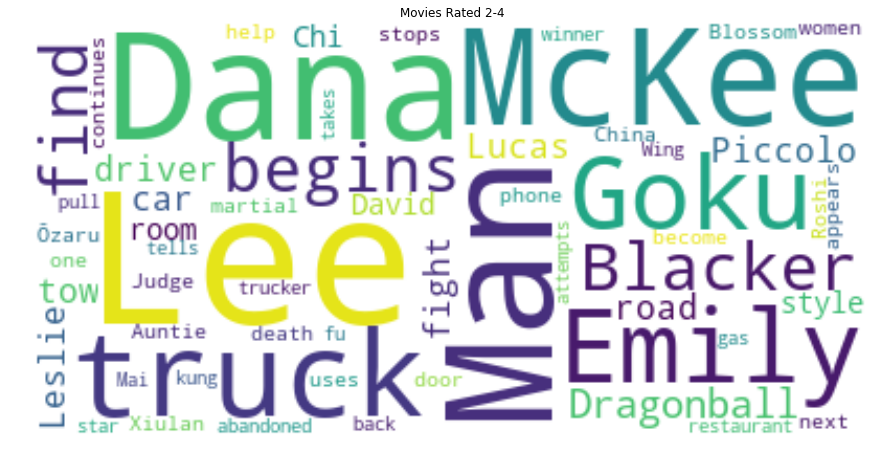

In [38]:
#Convert the plot sections from a list of strings to one string
movie_2_4_plots1="".join(movie_2_4_plots)

#processing
#Tokenization & remove all "."s and \d's
print(len(movie_2_4_plots1))
#Remove newlines
movie_2_4_plots1= movie_2_4_plots1.replace('\\n'," ").replace('.','')
print(len(movie_2_4_plots1))

tokenizer = RegexpTokenizer(r'\w+')
movie_2_4_plots1_tokens = tokenizer.tokenize(movie_2_4_plots1)
print(len(movie_2_4_plots1))

#Remove stop words & lower
stopset = set(stopwords.words('english'))
movie_2_4_plots1_tokens = [w for w in movie_2_4_plots1_tokens if not w in stopset]

print(len(movie_2_4_plots1_tokens))
print(len(set(movie_2_4_plots1_tokens)))

#calculate the tf and idf of every word:

#get the unique words:
plot_unique_words = set(movie_2_4_plots1_tokens)

plot_counts = Counter(movie_2_4_plots1_tokens)
index = 0 
tf_idf_plot = []
for n in plot_unique_words.union(plot_unique_words):
    n_t = 0
    if n in plot_unique_words:
        n_t = n_t+1
        
    word_idf = math.log10(2/n_t)    

    tf_idf_plot.append((n, plot_counts[n]*word_idf))
    
    
# word cloud

sortedlist = sorted(tf_idf_plot, key = lambda x: x[1], reverse =True)
text = ""
for i in range(100):
    text = text + int(sortedlist[i][1])*(sortedlist[i][0] + " ")
wc = WordCloud(background_color="white", max_words=300, collocations = False)
wc.generate(text)

# Show
plt.figure(figsize=(15,10))
plt.title("Movies Rated 2-4")
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show() 

The 2-4 range also contains very few movies.  In the word cloud, some movie titles and characters can be seen. It's impossible to conclude on a pattern here because of the size of this group.

**Wordcloud on plots from 4-6 movies**

601916
596564
596564
60408
13279


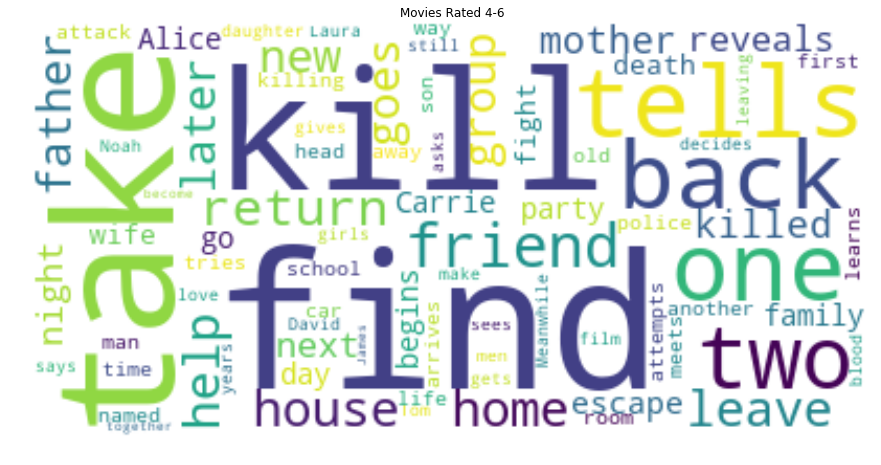

In [39]:
#Convert the plot sections from a list of strings to one string
movie_4_6_plots1="".join(movie_4_6_plots)

#processing
#Tokenization & remove all "."s and \d's
print(len(movie_4_6_plots1))
#Remove newlines
movie_4_6_plots1= movie_4_6_plots1.replace('\\n'," ").replace('.','')
print(len(movie_4_6_plots1))

tokenizer = RegexpTokenizer(r'\w+')
movie_4_6_plots1_tokens = tokenizer.tokenize(movie_4_6_plots1)
print(len(movie_4_6_plots1))

#Remove stop words & lower
stopset = set(stopwords.words('english'))
movie_4_6_plots1_tokens = [w for w in movie_4_6_plots1_tokens if not w in stopset]

print(len(movie_4_6_plots1_tokens))
print(len(set(movie_4_6_plots1_tokens)))

#calculate the tf and idf of every word:

#get the unique words:
plot_unique_words = set(movie_4_6_plots1_tokens)

plot_counts = Counter(movie_4_6_plots1_tokens)
index = 0 
tf_idf_plot = []
for n in plot_unique_words.union(plot_unique_words):
    n_t = 0
    if n in plot_unique_words:
        n_t = n_t+1
        
    word_idf = math.log10(2/n_t)    

    tf_idf_plot.append((n, plot_counts[n]*word_idf))
    
    
# word cloud

sortedlist = sorted(tf_idf_plot, key = lambda x: x[1], reverse =True)
text = ""
for i in range(100):
    text = text + int(sortedlist[i][1])*(sortedlist[i][0] + " ")
wc = WordCloud(background_color="white", max_words=300, collocations = False)
wc.generate(text)

# Show
plt.figure(figsize=(15,10))
plt.title("Movies Rated 4-6")
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show() 

Now we are getting into a group with a sufficient number of movies. From the word cloud we can see that a lot of the words are typical storytelling words(i.e. find, tells, take, later etc.). This makes sense, but this doesn't tell us much. However we also see that killing is a reoccurring element in the movies (which is typical for a lot of Hollywood movies). There is also accouring a lot of different roles like: father, mother, wife and friend.

**Wordcloud on plots from 6-8 movies**

2676628
2652896
2652896
268363
32731


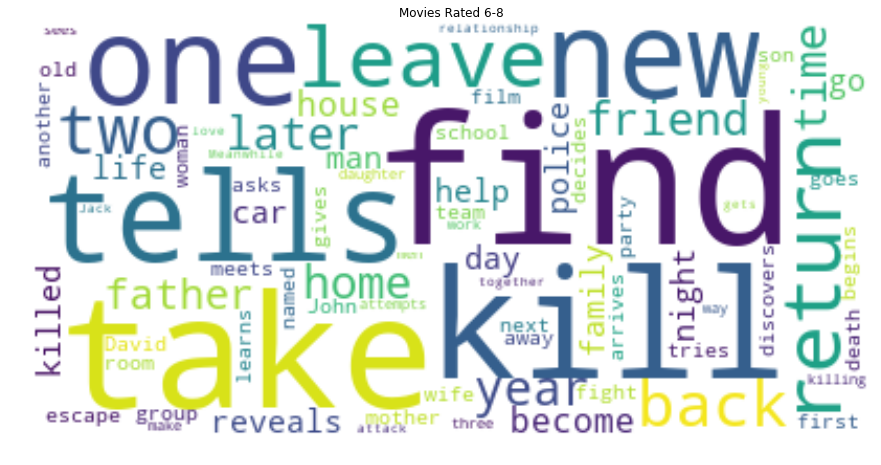

In [40]:
#Convert the plot sections from a list of strings to one string
movie_6_8_plots1="".join(movie_6_8_plots)

#processing

#Tokenization & remove all "."s and \d's
print(len(movie_6_8_plots1))
#Remove newlines
movie_6_8_plots1= movie_6_8_plots1.replace('\\n'," ").replace('.','')
print(len(movie_6_8_plots1))

tokenizer = RegexpTokenizer(r'\w+')
movie_6_8_plots1_tokens = tokenizer.tokenize(movie_6_8_plots1)
print(len(movie_6_8_plots1))

#Remove stop words & lower
stopset = set(stopwords.words('english'))
movie_6_8_plots1_tokens = [w for w in movie_6_8_plots1_tokens if not w in stopset]

print(len(movie_6_8_plots1_tokens))
print(len(set(movie_6_8_plots1_tokens)))

#calculate the tf and idf of every word:
import math
from collections import Counter

#get the unique words:
plot_unique_words = set(movie_6_8_plots1_tokens)

plot_counts = Counter(movie_6_8_plots1_tokens)
index = 0 
tf_idf_plot = []
for n in plot_unique_words.union(plot_unique_words):
    n_t = 0
    if n in plot_unique_words:
        n_t = n_t+1
        
    word_idf = math.log10(2/n_t)    

    tf_idf_plot.append((n, plot_counts[n]*word_idf))
    
    
# word cloud

sortedlist = sorted(tf_idf_plot, key = lambda x: x[1], reverse =True)
text = ""
for i in range(100):
    text = text + int(sortedlist[i][1])*(sortedlist[i][0] + " ")
wc = WordCloud(background_color="white", max_words=300, collocations = False)
wc.generate(text)

# Show
plt.figure(figsize=(15,10))
plt.title("Movies Rated 6-8")
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show() 

The 6-8 rating wordcloud looks almos identical to the 4-6 one. Although there is some different in the size of the words. 

**Wordcloud on plots from 8-10 movies**

213695
211749
211749
21488
7386


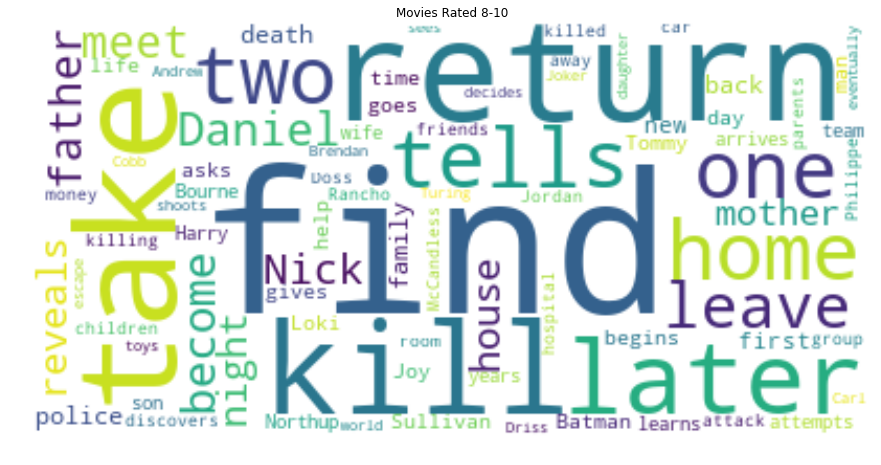

In [41]:
#Convert the plot sections from a list of strings to one string
movie_8_10_plots1="".join(movie_8_10_plots)

#processing

#Tokenization & remove all "."s and \d's
print(len(movie_8_10_plots1))
#Remove newlines
movie_8_10_plots1= movie_8_10_plots1.replace('\\n'," ").replace('.','')
print(len(movie_8_10_plots1))

tokenizer = RegexpTokenizer(r'\w+')
movie_8_10_plots1_tokens = tokenizer.tokenize(movie_8_10_plots1)
print(len(movie_8_10_plots1))

#Remove stop words & lower
stopset = set(stopwords.words('english'))
movie_8_10_plots1_tokens = [w for w in movie_8_10_plots1_tokens if not w in stopset]

print(len(movie_8_10_plots1_tokens))
print(len(set(movie_8_10_plots1_tokens)))

#calculate the tf and idf of every word:

#get the unique words:
plot_unique_words = set(movie_8_10_plots1_tokens)

plot_counts = Counter(movie_8_10_plots1_tokens)
index = 0 
tf_idf_plot = []
for n in plot_unique_words.union(plot_unique_words):
    n_t = 0
    if n in plot_unique_words:
        n_t = n_t+1
        
    word_idf = math.log10(2/n_t)    

    tf_idf_plot.append((n, plot_counts[n]*word_idf))
    
    
# word cloud

sortedlist = sorted(tf_idf_plot, key = lambda x: x[1], reverse =True)
text = ""
for i in range(100):
    text = text + int(sortedlist[i][1])*(sortedlist[i][0] + " ")
wc = WordCloud(background_color="white", max_words=300, collocations = False)
wc.generate(text)

# Show
plt.figure(figsize=(15,10))
plt.title("Movies Rated 8-10")
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show() 

This is the last group with the top rated movies. Again, theres a lot of similair words as the past word clouds and therefore difficult to see the difference between the word clouds. But you do see some specific movie franchises (Batman, Bourne) and characters (Joker, McCandless, Loki). 

## Collect data from cast section

In [42]:
#Look at movies with rating above 7 only
popularmovie_casts=[]
for index, row in movies.iterrows():
    
    film=movies.Title[index]+' ('+str(movies.Year[index])+' film)'
    if movies.Rating[index]>7:
        
        

        try:
            # get the section of a page. In this case the Cast description 
            section = wikipedia.WikipediaPage(film).section('Cast')

            # that will return fairly clean text, but the next line of code
            # will help clean that up.
            section = section.replace('\n','').replace("\'","")
            popularmovie_casts.append(section)

        except:
            try: 
                film=movies.Title[index]+' (film)'
                section = wikipedia.WikipediaPage(film).section('Cast')

                section = section.replace('\n','').replace("\'","")
                popularmovie_casts.append(section)

                #Skip movie if it doesnt findt it 

            except:   
                try: 
                    film=movies.Title[index]
                    
                    section = wikipedia.WikipediaPage(film).section('Cast')

                    section = section.replace('\n','').replace("\'","")
                    popularmovie_casts.append(section)

                except:
                    try: 
                        film=movies.Title[index]+' ('+str(movies.Year[index])+' American film)'
                        section = wikipedia.WikipediaPage(film).section('Cast')

                        section = section.replace('\n','').replace("\'","")
                        popularmovie_cassts.append(section)

                    except:
                        pass


C:\Users\danma\Anaconda3\lib\site-packages\bs4\__init__.py:181: UserWarning: No parser was explicitly specified, so I'm using the best available HTML parser for this system ("lxml"). This usually isn't a problem, but if you run this code on another system, or in a different virtual environment, it may use a different parser and behave differently.

The code that caused this warning is on line 193 of the file C:\Users\danma\Anaconda3\lib\runpy.py. To get rid of this warning, change code that looks like this:

 BeautifulSoup(YOUR_MARKUP})

to this:

 BeautifulSoup(YOUR_MARKUP, "lxml")

  markup_type=markup_type))


In [43]:
#Look at movies with ratings less than 6only
unpopularmovie_casts=[]
for index, row in movies.iterrows():
    #print(index)
    film=movies.Title[index]+' ('+str(movies.Year[index])+' film)'
    if movies.Rating[index]<6:
        
        #print(film)

        try:
            # get the section of a page. In this case the Cast description 
            section = wikipedia.WikipediaPage(film).section('Cast')

            section = section.replace('\n','').replace("\'","")
            unpopularmovie_casts.append(section)

        except:
            try: 
                film=movies.Title[index]+' (film)'
                section = wikipedia.WikipediaPage(film).section('Cast')

                section = section.replace('\n','').replace("\'","")
                unpopularmovie_casts.append(section)

                #Skip movie if it doesnt findt it 

            except:   
                try: 
                    film=movies.Title[index]
                    section = wikipedia.WikipediaPage(film).section('Cast')

                    section = section.replace('\n','').replace("\'","")
                    unpopularmovie_casts.append(section)

                except:
                    try: 
                        film=movies.Title[index]+' ('+str(movies.Year[index])+' American film)'
                        section = wikipedia.WikipediaPage(film).section('Cast')

                        section = section.replace('\n','').replace("\'","")
                        unpopularmovie_cassts.append(section)

                    except:
                        pass


C:\Users\danma\Anaconda3\lib\site-packages\bs4\__init__.py:181: UserWarning: No parser was explicitly specified, so I'm using the best available HTML parser for this system ("lxml"). This usually isn't a problem, but if you run this code on another system, or in a different virtual environment, it may use a different parser and behave differently.

The code that caused this warning is on line 193 of the file C:\Users\danma\Anaconda3\lib\runpy.py. To get rid of this warning, change code that looks like this:

 BeautifulSoup(YOUR_MARKUP})

to this:

 BeautifulSoup(YOUR_MARKUP, "lxml")

  markup_type=markup_type))


In [44]:
#Convert the cast of popularmovies from a list of strings to one string
cast1="".join(popularmovie_casts)

446357
442255
73550
46011
15176


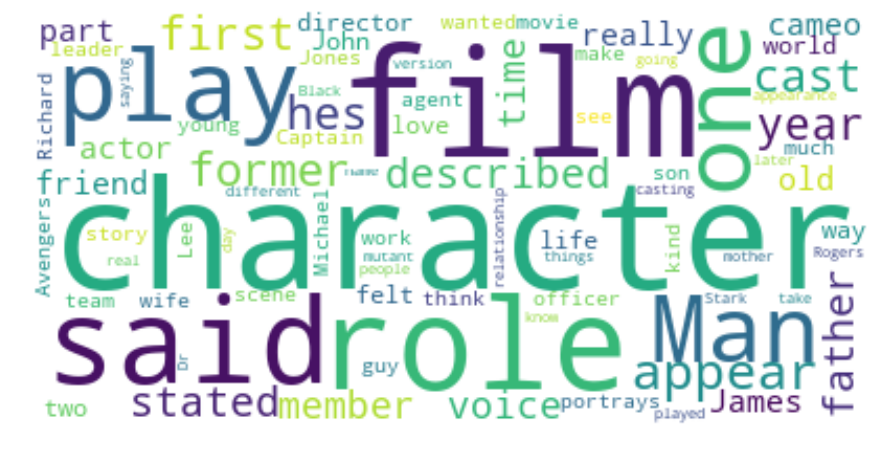

In [45]:
#processing

#Tokenization & remove all "."s and \d's
print(len(cast1))
#Remove newlines
cast1= cast1.replace('\\n'," ").replace('.','')
print(len(cast1))

tokenizer = RegexpTokenizer(r'\w+')
cast_tokens = tokenizer.tokenize(cast1)
print(len(cast_tokens))

#Remove stop words & lower
stopset = set(stopwords.words('english'))
cast_tokens = [w for w in cast_tokens if not w in stopset]

print(len(cast_tokens))
print(len(set(cast_tokens)))

#calculate the tf and idf of every word:

#get the unique words:
cast_unique_words = set(cast_tokens)

cast_counts = Counter(cast_tokens)
index = 0 
tf_idf_cast = []
for n in cast_unique_words.union(cast_unique_words):
    n_t = 0
    if n in cast_unique_words:
        n_t = n_t+1
        
    word_idf = math.log10(2/n_t)    

    tf_idf_cast.append((n, cast_counts[n]*word_idf))

#word cloud
from PIL import Image
from wordcloud import WordCloud

sortedlist = sorted(tf_idf_cast, key = lambda x: x[1], reverse =True)
text = ""
for i in range(100):
    text = text + int(sortedlist[i][1])*(sortedlist[i][0] + " ")
wc = WordCloud(background_color="white", max_words=300, collocations = False)
wc.generate(text)

# Show
plt.figure(figsize=(15,10))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show() 

The word cloud contains many obvious casting related words (like character, film, role, play etc.), but also recurring names and characters.

In [46]:
#Convert the casts of unpopularmove from a list of strings to one string
cast1="".join(unpopularmovie_casts)

99331
98547
15919
10237
5885


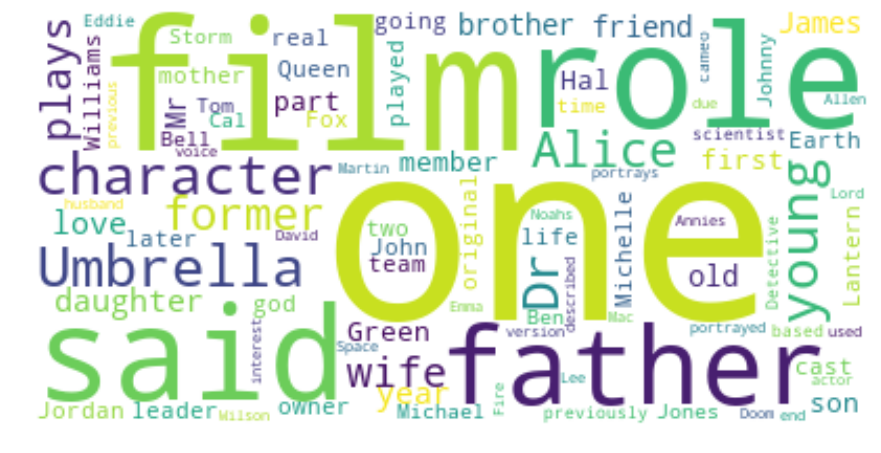

In [47]:
#processing
#Tokenization & remove all "."s and \d's
print(len(cast1))
#Remove newlines
cast1= cast1.replace('\\n'," ").replace('.','')
print(len(cast1))

tokenizer = RegexpTokenizer(r'\w+')
cast_tokens = tokenizer.tokenize(cast1)
print(len(cast_tokens))

#Remove stop words & lower
stopset = set(stopwords.words('english'))
cast_tokens = [w for w in cast_tokens if not w in stopset]

print(len(cast_tokens))
print(len(set(cast_tokens)))


#calculate the tf and idf of every word:


#get the unique words:
cast_unique_words = set(cast_tokens)

cast_counts = Counter(cast_tokens)
index = 0 
tf_idf_cast = []
for n in cast_unique_words.union(cast_unique_words):
    n_t = 0
    if n in cast_unique_words:
        n_t = n_t+1
        
    word_idf = math.log10(2/n_t)    

    tf_idf_cast.append((n, cast_counts[n]*word_idf))

#word cloud

sortedlist = sorted(tf_idf_cast, key = lambda x: x[1], reverse =True)
text = ""
for i in range(100):
    text = text + int(sortedlist[i][1])*(sortedlist[i][0] + " ")
wc = WordCloud(background_color="white", max_words=300, collocations = False)
wc.generate(text)

# Show
plt.figure(figsize=(15,10))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show() 

Besides the casting related words, there are many new characters and general words compared to the popular movie word cloud.   It still is difficult to conclude anything on this. It would be harsh to say that movies with umbrellas is destined to be a bad movie. However, it describes more words that are common specifically in **our dataset**.



## Sentiment analysis

Lastly we wish to explore the sentiment of plots from our wikipedia pages to try and explore if the writing and plot is sentimentally positive or negative.

In [48]:
import nltk
#Set the path for the Data Set S1 txt file from Lab MT
path = 'sentimentWords.TXT'
header = ['word', 'hapiness_rank', 'happiness_average', 'hapiness_standard_deviation', 'twitter_rank', 'google_rank', 'nyt_rank', 'lyrics_rank']
happy_data = pd.read_csv(path, delimiter='\t',skiprows=3)
happinessDict = dictionary = dict(zip(happy_data.word, happy_data.happiness_average))

#function that calculates sentiment

def how_happy(tokens):# Given tokens return happines
    
    happiness_counter=[]
    for word in tokens:
        word = word.lower()
                
        happiness_word=happinessDict.get(word,0)
        if happiness_word != 0:
            happiness_counter.append(happiness_word)
    
    
    happiness_counter=np.mean(happiness_counter)
    return happiness_counter


In [49]:
popularmovie_plots=movie_8_10_plots+movie_6_8_plots


sentiment_popularmovie_plot=[]

for n in popularmovie_plots:
    
    try:
        sentiment_popularmovie_plot.append(how_happy(nltk.word_tokenize(n)))
        
    except:
        pass

C:\Users\danma\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2957: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
C:\Users\danma\Anaconda3\lib\site-packages\numpy\core\_methods.py:80: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


In [50]:
unpopularmovie_plots=movie_0_2_plots+movie_2_4_plots+movie_4_6_plots

sentiment_unpopularmovie_plot=[]

for n in unpopularmovie_plots:
    
    try:
        sentiment_unpopularmovie_plot.append(how_happy(nltk.word_tokenize(n)))
        
    except:
        pass

In [51]:
#remove nans
sentiment_popularmovie_plot = [x for x in sentiment_popularmovie_plot if str(x) != 'nan']
#remove nans
sentiment_unpopularmovie_plot = [x for x in sentiment_unpopularmovie_plot if str(x) != 'nan']


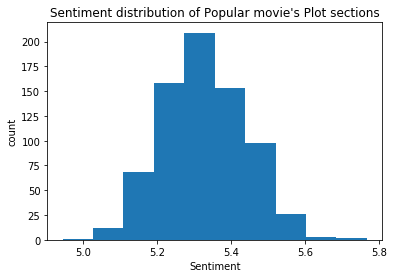

Mean sentiment of popularmovie plots:
5.327852686398143
Std sentiment of popularmovie plots:
0.1115029270047238


In [52]:
plt.hist(sentiment_popularmovie_plot)
plt.title("Sentiment distribution of Popular movie's Plot sections")
plt.ylabel('count')
plt.xlabel('Sentiment')

#plt.xlim(3,8)
plt.show()

mean_popularmovie_plot=np.mean(sentiment_popularmovie_plot)
print('Mean sentiment of popularmovie plots:')
print(mean_popularmovie_plot)
std_popularmovie_plot=np.std(sentiment_popularmovie_plot)
print('Std sentiment of popularmovie plots:')
print(std_popularmovie_plot)

The popular movie plots are not diverse in their sentiment and they are all fairly neutral in happiness score.

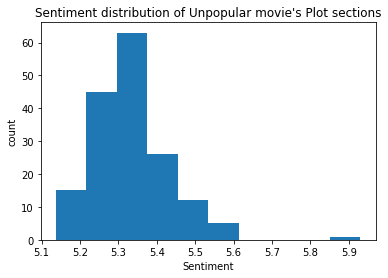

Mean sentiment of unpopularmovie plots:
5.335173639637189
Std sentiment of unpopularmovie plots:
0.10259497856974376


In [53]:
plt.hist(sentiment_unpopularmovie_plot)
plt.title("Sentiment distribution of Unpopular movie's Plot sections")
plt.ylabel('count')
plt.xlabel('Sentiment')
#plt.xlim(3,8)
plt.show()

mean_unpopularmovie_plot=np.mean(sentiment_unpopularmovie_plot)
print('Mean sentiment of unpopularmovie plots:')
print(mean_unpopularmovie_plot)
std_unpopularmovie_plot=np.std(sentiment_unpopularmovie_plot)
print('Std sentiment of unpopularmovie plots:')
print(std_unpopularmovie_plot)

The sentiment distribuiton of unpopular movie plots are almost identical to the popular movies. It got one extra "happy" outlier. 

## Discussion. Think critically about your creation
- __What went well?,__

Initially we learned a lot about actor interconnectivity in movies, its evident from our visualizations that highly rated actors connect to other highly rated actors. This also creates a large connected component of actors who share links, connecting most actors to one another. There are however other connected components especially in the actors graphs where small group of low end actors are connected by a single movie, and this is also shown in our plots. 

- __What is still missing? What could be improved?, Why?__

Intially we managed to complete the exploration we set out to do, during this exploration it became somewhat apparent that our initial goals for exploring movie plots were to shallow. Rather upon reflection we should have included the scripts for exploration, including wordclouds and sentiment analysis of these scripts, as we belive this may have more accurately highlighted individual movie trends. 

While we have intially gained an understanding of how movies and actors connect with one another through their movies and how high end actors are highly interconnected, we have yet to understand what truly makes a movie popular. Intially there is some indication that it might be the actors, however we simply have too little data to conclude this. Our analysis of movie plots highlighted some insights, however nothing truly definitive 

A large potential point of improvement might be to start diving deeper into movie plots, seperating them by genres and trying to conclude what makes a popular movie within each genre rather than a more broad exploration.

## Conclusion
During this notebook a broad exploration approach was used, attempting to broadly explore elements of movies which might attribute to movie success. While this highlighted that indeed actors have a role to play, and that income for movies relative to their rating seems to have a correlation, this provides by no means definitive proof of trends. We may however conclude that a broad analysis of movie similarities are not enough to make worthwhile conclusions about what makes a movie popular or even successful. 

It may also be argued that the genre of movies has a large influence on the popularity of a movie, and that a deeper analysis of plot elements from different genres will likely be more meaningful, as it can be argued that accross genres not definitive elements can be identified. Logically, this could be due to for example westerns and sci-fi movies attracting different audiences and in turn has different elements making the movies popular. E.i. a popular western may not share common plot elements with a sci-fi movie. 

Overall, while there has been some indications in regards to what makes popular movies, nothing definitive can be identified. On the other hand what has been discovered is which aspects seem not to play a role in movies popularity, which in of itself is the point of an exploratory analysis. In the future, exploration could continue with a new more focused point of view based on the learnings of this initial exploration. Once more the tools presented in this course would be useful for such an exploration.